## Setup Instructions
- ignore this if you already configured a python environment with required dependencies and fiji ImageJ.
- Follow setup instruction on [ImageJ Github page](https://github.com/imagej/pyimagej) on creating an environment and install pyImageJ. You can choose not to use `mamba` as in the document, but using it will save a bunch of time and nontrivial debugging issues. Note that a Java JDK is also required. After setup, restart the computer and try to activate the environment. If `print(os.environ['JAVA_HOME'])` prints the corresponding python library path, then you can proceed to the next step.
- Install latest [Fiji ImageJ](https://imagej.net/software/fiji/) on your computer. Change the following `app_path` to point to the `fiji` folder.

## Section 1. Stabilizer

- read in raw input tif image sequence and pass through [fiji ImageJ](https://imagej.net/software/fiji/) [Image_Stabilizer](https://imagej.net/plugins/image-stabilizer) plugin
- This jupyter notebook requires you have a **local** installation of the latest imagej.
- Download the modified version of the plugin, `Image_Stabilizer_Headless.java`, and move it under the folder of `fiji/plugin`. To verify it is working, restart ImageJ and check if `Image Stabilizer Headless` appears under `Plugins` drop down menu.
- You don't need to open ImageJ while running this section.

In [ ]:
import numpy as np
import imagej, scyjava
from scyjava import jimport
import os, sys, time

#### Initialize ImageJ

In [ ]:
app_path = "D:\\CanYing\\Fiji.app"  # Change this to the directory to local imagej
ij = imagej.init(app_path, mode="interactive")
"""
Ignore the following errors if any when executing this cell:
java.lang.ClassNotFoundException: loci.formats.in.URLReader
java.lang.ClassNotFoundException: loci.formats.in.SlideBook6Reader
java.lang.ClassNotFoundException: loci.formats.in.ScreenReader
java.lang.ClassNotFoundException: loci.formats.in.ZarrReader
"""
print(f"ImageJ version: {ij.getVersion()}")
# if any error occurs executing following cells, check if fiji is the latest version.

Choose between image sequence or a single movie:

In [ ]:
# False if a sequence of tif images, True if a single tif movie
seq_movie_r = True
# Change fpath_in to the path to the folder if use image sequence, or path to the movie.
fpath_in = "E:\\case1 Movie_57.tif" # fpath_in = "D:\\CanYing\\Code\\Columbia\\tiny"
FolderOpener = jimport("ij.plugin.FolderOpener")

In [ ]:
if not seq_movie_r:
    imp = FolderOpener.open(fpath_in, "")
else:
    imp = ij.IJ.openImage(fpath_in)
dims = imp.getDimensions()
print(f"Loading images with width * height: [{dims[0]} * {dims[1]}], total of {dims[3]} slices.")

#### Run Image_Stabilizer

In [ ]:
#movie 57 ~360 rotation
# Choose the params you want to pass to the stabilizer
Transformation = "Translation"  # or "Affine"
MAX_Pyramid_level = 1
update_coefficient = 0.90
MAX_iteration = 200
error_tolerance = 1E-7

In [ ]:
stime = time.time()
ij.IJ.run(imp, "Image Stabilizer Headless",
       "transformation=" + Transformation + " maximum_pyramid_levels=" + str(MAX_Pyramid_level) +
       " template_update_coefficient=" + str(update_coefficient) + " maximum_iterations=" + str(MAX_iteration) +
       " error_tolerance=" + str(error_tolerance))
print(f"Task finishes. Total of {int((time.time() - stime) // 60)} m {int((time.time() - stime) % 60)} s.")

#### Save **stabilized** tif image sequence to a desired **empty** directory

In [ ]:
# False if a sequence of tif images, True if a single tif movie
seq_movie_w = True
# Filepath to the empty directory if save to a sequence, or the tiff movie name if save to a single movie
fpath_out = "E:\\case1 Movie_57_sb.tif"     # You don't have to specify individual name if saving to image sequence, just to an empty folder

In [ ]:
if not seq_movie_w:
    # Adjust number of 0s in "/out_0s1.tif" for different number of images in the sequence
    ij.IJ.run(imp, "Image Sequence... ", "format=TIFF save=[" + fpath_out + "]")  # + "/out_0001.tif" + "]")
else:
    ij.IJ.saveAs(imp, "Tiff", fpath_out)

imp.close()

#### For Quality Control

In [ ]:
# False if a sequence of tif images, True if a single tif movie
seq_movie_gt = True
# Filepath to the empty directory if save to a sequence, or the tiff movie name if save to a single movie
fpath_gt = "E:\\Stablized_case1 Movie_57.tif" # You don't have to specify individual name if saving to image sequence, just to an empty folder

In [ ]:
if not seq_movie_gt:
    groundtruth_imp = FolderOpener.open(fpath_gt, "")
else:
    print(f"Opening input movie...")
    groundtruth_imp = ij.IJ.openVirtual(fpath_gt)
dims = groundtruth_imp.getDimensions()
print(f"Loading ground truth images with width * height: [{dims[0]} * {dims[1]}], total of {dims[3]} slices.")
if not seq_movie_r:
    original_imp = FolderOpener.open(fpath_in, "")
else:
    print(f"Opening input movie...")
    original_imp = ij.IJ.openVirtual(fpath_in)
dims = original_imp.getDimensions()
print(f"Loading original images with width * height: [{dims[0]} * {dims[1]}], total of {dims[3]} slices.")
if not seq_movie_w:
    processed_imp = FolderOpener.open(fpath_out, "")
else:
    print(f"Opening output movie...")
    processed_imp = ij.IJ.openVirtual(fpath_out)
dims = processed_imp.getDimensions()
print(f"Loading processed images with width * height: [{dims[0]} * {dims[1]}], total of {dims[3]} slices.")

ij.ui().show(original_imp)
ij.ui().show(processed_imp)
ij.IJ.run("Synchronize Windows", "")

In [ ]:
# Closing all Images
if groundtruth_imp is not None:
    groundtruth_imp.close()
    groundtruth_imp = None
if original_imp is not None:
    original_imp.close()
    original_imp = None
if processed_imp is not None:
    processed_imp.close()
    processed_imp = None

## Section 2. CaImAn

      159621 [__init__.py:            <module>():47] [17088] Creating converter from 7 to 5
      159623 [__init__.py:            <module>():47] [17088] Creating converter from 5 to 7
      159623 [__init__.py:            <module>():47] [17088] Creating converter from 7 to 5
      159624 [__init__.py:            <module>():47] [17088] Creating converter from 5 to 7
      159764 [__init__.py:             wrapper():275] [17088] matplotlib data path: C:\Users\wyari\.conda\envs\caiman\lib\site-packages\matplotlib\mpl-data
      159769 [__init__.py:             wrapper():275] [17088] CONFIGDIR=C:\Users\wyari\.matplotlib
      159771 [__init__.py:            <module>():1445] [17088] interactive is False
      159772 [__init__.py:            <module>():1446] [17088] platform is win32
      159772 [__init__.py:            <module>():1447] [17088] loaded modules: ['sys', 'builtins', '_frozen_importlib', '_imp', '_thread', '_warnings', '_weakref', '_io', 'marshal', 'nt', 'winreg', '_frozen_impor

      159896 [__init__.py:             wrapper():275] [17088] CACHEDIR=C:\Users\wyari\.matplotlib
      159900 [font_manager.py:   _load_fontmanager():1439] [17088] Using fontManager instance from C:\Users\wyari\.matplotlib\fontlist-v330.json
      167507 [tpu_cluster_resolver.py:            <module>():35] [17088] Falling back to TensorFlow client; we recommended you install the Cloud TPU client directly with pip install cloud-tpu-client.


Loading BokehJS ...

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
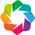

In [1]:
import logging
logging.basicConfig(format=
                          "%(relativeCreated)12d [%(filename)s:%(funcName)20s():%(lineno)s] [%(process)d] %(message)s",
                    # filename="/tmp/caiman.log",
                    level=logging.DEBUG)
import caiman as cm
import matplotlib.pyplot as plt
from caiman.source_extraction import cnmf
from caiman.utils.utils import download_demo
from caiman.utils.visualization import inspect_correlation_pnr, nb_inspect_correlation_pnr
from caiman.motion_correction import MotionCorrect
from caiman.source_extraction.cnmf import params as params
from caiman.utils.visualization import plot_contours, nb_view_patches, nb_plot_contour
import cv2

# try:
#     cv2.setNumThreads(0)
# except:
#     pass
import bokeh.plotting as bpl
import holoviews as hv
bpl.output_notebook()
hv.notebook_extension('bokeh')

### Select file(s) to be processed
The `download_demo` function will download the specific file for you and return the complete path to the file which will be stored in your `caiman_data` directory. If you adapt this demo for your data make sure to pass the complete path to your file(s). Remember to pass the `fnames` variable as a list. Note that the memory requirement of the CNMF-E algorithm are much higher compared to the standard CNMF algorithm. Test the limits of your system before trying to process very large amounts of data.

In [2]:
fnames = ['E:\\Crop_Movie_57_stabilized.tif']  # filename to be processed
#fnames = [download_demo(fnames[0])]

### Setup some parameters
We first set some parameters related to the data and motion correction and create a `params` object. We'll modify this object with additional settings later on. You can also set all the parameters at once as demonstrated in the `demo_pipeline.ipynb` notebook.

In [3]:
# dataset dependent parameters
frate = 10                       # movie frame rate
decay_time = 0.4                 # length of a typical transient in seconds

# motion correction parameters
motion_correct = False    # flag for performing motion correction
pw_rigid = False         # flag for performing piecewise-rigid motion correction (otherwise just rigid)
gSig_filt = (3, 3)       # size of high pass spatial filtering, used in 1p data
max_shifts = (5, 5)      # maximum allowed rigid shift
strides = (48, 48)       # start a new patch for pw-rigid motion correction every x pixels
overlaps = (24, 24)      # overlap between pathes (size of patch strides+overlaps)
max_deviation_rigid = 3  # maximum deviation allowed for patch with respect to rigid shifts
border_nan = 'copy'      # replicate values along the boundaries

mc_dict = {
    'fnames': fnames,
    'fr': frate,
    'decay_time': decay_time,
    'pw_rigid': pw_rigid,
    'max_shifts': max_shifts,
    'gSig_filt': gSig_filt,
    'strides': strides,
    'overlaps': overlaps,
    'max_deviation_rigid': max_deviation_rigid,
    'border_nan': border_nan
}

opts = params.CNMFParams(params_dict=mc_dict)

      386139 [params.py:                 set():973] [17088] Changing key fnames in group data from None to ['E:\\Crop_Movie_57_stabilized.tif']
      386139 [params.py:                 set():973] [17088] Changing key fr in group data from 30 to 10
      386140 [params.py:                 set():973] [17088] Changing key max_shifts in group motion from (6, 6) to (5, 5)
      386141 [params.py:                 set():973] [17088] Changing key gSig_filt in group motion from None to (3, 3)
      386141 [params.py:                 set():973] [17088] Changing key strides in group motion from (96, 96) to (48, 48)
      386141 [params.py:                 set():973] [17088] Changing key overlaps in group motion from (32, 32) to (24, 24)


### Motion Correction
The background signal in micro-endoscopic data is very strong and makes the motion correction challenging.
As a first step the algorithm performs a high pass spatial filtering with a Gaussian kernel to remove the bulk of the background and enhance spatial landmarks.
The size of the kernel is given from the parameter `gSig_filt`. If this is left to the default value of `None` then no spatial filtering is performed (default option, used in 2p data).
After spatial filtering, the NoRMCorre algorithm is used to determine the motion in each frame. The inferred motion is then applied to the *original* data so no information is lost.

The motion corrected files are saved in memory mapped format. If no motion correction is being performed, then the file gets directly memory mapped.

In [4]:
if motion_correct:
    # do motion correction rigid
    mc = MotionCorrect(fnames, dview=None, **opts.get_group('motion'))
    mc.motion_correct(save_movie=True)
    fname_mc = mc.fname_tot_els if pw_rigid else mc.fname_tot_rig
    if pw_rigid:
        bord_px = np.ceil(np.maximum(np.max(np.abs(mc.x_shifts_els)),
                                     np.max(np.abs(mc.y_shifts_els)))).astype(np.int)
    else:
        bord_px = np.ceil(np.max(np.abs(mc.shifts_rig))).astype(np.int)
        plt.subplot(1, 2, 1); plt.imshow(mc.total_template_rig)  # % plot template
        plt.subplot(1, 2, 2); plt.plot(mc.shifts_rig)  # % plot rigid shifts
        plt.legend(['x shifts', 'y shifts'])
        plt.xlabel('frames')
        plt.ylabel('pixels')

    bord_px = 0 if border_nan is 'copy' else bord_px
    fname_new = cm.save_memmap(fname_mc, base_name='memmap_', order='C',
                               border_to_0=bord_px)
else:  # if no motion correction just memory map the file
    bord_px = 0
    fname_new = cm.save_memmap(fnames, base_name='memmap_',
                               order='C', border_to_0=0, dview=None)

<>:17: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:17: SyntaxWarning: "is" with a literal. Did you mean "=="?
C:\Users\wyari\AppData\Local\Temp\ipykernel_17088\2620529395.py:17: SyntaxWarning: "is" with a literal. Did you mean "=="?
  bord_px = 0 if border_nan is 'copy' else bord_px
      388355 [mmapping.py:         save_memmap():439] [17088] E:\Crop_Movie_57_stabilized.tif
      394361 [mmapping.py:         save_memmap():514] [17088] SAVING WITH numpy.tofile()


### Load memory mapped file

In [5]:
# load memory mappable file
Yr, dims, T = cm.load_memmap(fname_new)
images = Yr.T.reshape((T,) + dims, order='F')

### Parameter setting for CNMF-E
We now define some parameters for the source extraction step using the CNMF-E algorithm.
We construct a new dictionary and use this to modify the *existing* `params` object,

In [6]:
# parameters for source extraction and deconvolution
p = 1               # order of the autoregressive system
K = None            # upper bound on number of components per patch, in general None
gSig = (3, 3)       # gaussian width of a 2D gaussian kernel, which approximates a neuron
gSiz = (13, 13)     # average diameter of a neuron, in general 4*gSig+1
Ain = None          # possibility to seed with predetermined binary masks
merge_thr = .7      # merging threshold, max correlation allowed
rf = 40             # half-size of the patches in pixels. e.g., if rf=40, patches are 80x80
stride_cnmf = 20    # amount of overlap between the patches in pixels
#                     (keep it at least large as gSiz, i.e 4 times the neuron size gSig)
tsub = 2            # downsampling factor in time for initialization,
#                     increase if you have memory problems
ssub = 1            # downsampling factor in space for initialization,
#                     increase if you have memory problems
#                     you can pass them here as boolean vectors
low_rank_background = None  # None leaves background of each patch intact,
#                     True performs global low-rank approximation if gnb>0
gnb = 0             # number of background components (rank) if positive,
#                     else exact ring model with following settings
#                         gnb= 0: Return background as b and W
#                         gnb=-1: Return full rank background B
#                         gnb<-1: Don't return background
nb_patch = 0        # number of background components (rank) per patch if gnb>0,
#                     else it is set automatically
min_corr = .8       # min peak value from correlation image
min_pnr = 5        # min peak to noise ration from PNR image
ssub_B = 2          # additional downsampling factor in space for background
ring_size_factor = 1.4  # radius of ring is gSiz*ring_size_factor

opts.change_params(params_dict={'method_init': 'corr_pnr',  # use this for 1 photon
                                'K': K,
                                'gSig': gSig,
                                'gSiz': gSiz,
                                'merge_thr': merge_thr,
                                'p': p,
                                'tsub': tsub,
                                'ssub': ssub,
                                'rf': rf,
                                'stride': stride_cnmf,
                                'only_init': True,    # set it to True to run CNMF-E
                                'nb': gnb,
                                'nb_patch': nb_patch,
                                'method_deconvolution': 'oasis',       # could use 'cvxpy' alternatively
                                'low_rank_background': low_rank_background,
                                'update_background_components': True,  # sometimes setting to False improve the results
                                'min_corr': min_corr,
                                'min_pnr': min_pnr,
                                'normalize_init': False,               # just leave as is
                                'center_psf': True,                    # leave as is for 1 photon
                                'ssub_B': ssub_B,
                                'ring_size_factor': ring_size_factor,
                               }
                  )

      399639 [params.py:                 set():973] [17088] Changing key rf in group patch from None to 40
      399640 [params.py:                 set():973] [17088] Changing key stride in group patch from None to 20
      399641 [params.py:                 set():973] [17088] Changing key nb_patch in group patch from 1 to 0
      399641 [params.py:                 set():973] [17088] Changing key low_rank_background in group patch from True to None
      399642 [params.py:                 set():973] [17088] Changing key p in group preprocess from 2 to 1
      399642 [params.py:                 set():973] [17088] Changing key method_init in group init from greedy_roi to corr_pnr
      399643 [params.py:                 set():973] [17088] Changing key K in group init from 30 to None
      399643 [params.py:                 set():973] [17088] Changing key gSig in group init from [5, 5] to (3, 3)
      399644 [params.py:                 set():973] [17088] Changing key gSiz in group init fr

CNMFParams:

data:

{'caiman_version': '1.9.10',
 'decay_time': 0.4,
 'dims': (603, 629),
 'dxy': (1, 1),
 'fnames': ['E:\\Crop_Movie_57_stabilized.tif'],
 'fr': 10,
 'last_commit': 'FILE-1653261890',
 'mmap_C': None,
 'mmap_F': None,
 'var_name_hdf5': 'mov'}

spatial_params:

{'block_size_spat': 5000,
 'dist': 3,
 'expandCore': array([[0, 0, 1, 0, 0],
       [0, 1, 1, 1, 0],
       [1, 1, 1, 1, 1],
       [0, 1, 1, 1, 0],
       [0, 0, 1, 0, 0]]),
 'extract_cc': True,
 'maxthr': 0.1,
 'medw': None,
 'method_exp': 'dilate',
 'method_ls': 'lasso_lars',
 'n_pixels_per_process': None,
 'nb': 0,
 'normalize_yyt_one': True,
 'nrgthr': 0.9999,
 'num_blocks_per_run_spat': 20,
 'se': None,
 'ss': None,
 'thr_method': 'nrg',
 'update_background_components': True}

temporal_params:

{'ITER': 2,
 'bas_nonneg': False,
 'block_size_temp': 5000,
 'fudge_factor': 0.96,
 'lags': 5,
 'memory_efficient': False,
 'method_deconvolution': 'oasis',
 'nb': 0,
 'noise_method': 'mean',
 'noise_range': [0.25, 0

### Inspect summary images and set parameters
Check the optimal values of `min_corr` and `min_pnr` by moving slider in the figure that pops up. You can modify them in the `params` object.
Note that computing the correlation pnr image can be computationally and memory demanding for large datasets. In this case you can compute
only on a subset of the data (the results will not change). You can do that by changing `images[::1]` to `images[::5]` or something similar.
This will compute the correlation pnr image

In [7]:
# compute some summary images (correlation and peak to noise)
cn_filter, pnr = cm.summary_images.correlation_pnr(images[::10], gSig=gSig[0], swap_dim=False) # change swap dim if output looks weird, it is a problem with tiffile
# inspect the summary images and set the parameters
nb_inspect_correlation_pnr(cn_filter, pnr)

:Layout
   .AdjointLayout.Correlation :AdjointLayout
      :Image   [x,y]   (corr)
      :DynamicMap   []
         :Histogram   [corr]   (corr_count)
   .AdjointLayout.Pnr         :AdjointLayout
      :Image   [x,y]   (pnr)
      :DynamicMap   []
         :Histogram   [pnr]   (pnr_count)

You can inspect the correlation and PNR images to select the threshold values for `min_corr` and `min_pnr`. The algorithm will look for components only in places where these value are above the specified thresholds. You can adjust the dynamic range in the plots shown above by choosing the selection tool (third button from the left) and selecting the desired region in the histogram plots on the right of each panel.

In [8]:
# print parameters set above, modify them if necessary based on summary images
print(min_corr) # min correlation of peak (from correlation image)
print(min_pnr)  # min peak to noise ratio

0.8
5


### Run the CNMF-E algorithm

In [9]:
cnm = cnmf.CNMF(n_processes=6, dview=None, Ain=Ain, params=opts)
cnm.fit(images)

      416659 [params.py:                 set():973] [17088] Changing key n_processes in group patch from 1 to 6
      416659 [params.py:                 set():973] [17088] Changing key init_batch in group online from 200 to 1500
      416660 [cnmf.py:                 fit():470] [17088] (1500, 603, 629)
      416660 [cnmf.py:                 fit():487] [17088] Using 6 processes
      416661 [params.py:                 set():973] [17088] Changing key n_pixels_per_process in group preprocess from None to 63214
      416661 [params.py:                 set():973] [17088] Changing key n_pixels_per_process in group spatial from None to 63214
      416661 [cnmf.py:                 fit():498] [17088] using 63214 pixels per process
      416662 [cnmf.py:                 fit():499] [17088] using 5000 block_size_spat
      416663 [cnmf.py:                 fit():500] [17088] using 5000 block_size_temp
      416664 [params.py:                 set():973] [17088] Changing key n_pixels_per_process in g

      418888 [initialization.py:      greedyROI_corr():1388] [17088] Returning background as b0 and W
      418897 [map_reduce.py:        cnmf_patches():102] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 36180_84500START
      418898 [map_reduce.py:        cnmf_patches():104] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 36180_84500Read file
      418916 [map_reduce.py:        cnmf_patches():124] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 36180_84500file loaded
      419002 [cnmf.py:                 fit():457] [17088] Parallel processing in a single patch is not available for loaded in memory or sliced data.
      419003 [cnmf.py:                 fit():470] [17088] (1500, 81, 81)
      419003 [cnmf.py:                 fit():487] [17088] Using 1 processes
      419003 [cnmf.py:                 fit():498] [17088] using 1600 pixels per process
      419004 [cnmf.py:                 fit():499] [17088] using 5000 block_size_spat
      419004 [

      422255 [spatial.py:update_spatial_components():253] [17088] thresholding components
      422256 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      422257 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      422257 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      422258 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      422259 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      422273 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      422274 [temporal.py:    update_iteration():403] [17088] stopping: overall temporal component not changing significantly
      422274 [initialization.py:      greedyROI_corr():1284] [17088] Searching for more neurons in the residual
      422666 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
      422669 [in

      425720 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      426174 [spatial.py:update_spatial_components():253] [17088] thresholding components
      426185 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      426186 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      426186 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      426188 [initialization.py:      greedyROI_corr():1310] [17088] Updating temporal components
      426189 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      426206 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      426208 [temporal.py:    update_iteration():389] [17088] 3 out of total 10 temporal components updated
      426210 [temporal.py:    update_iteration():389] [17088] 6 out of total 10 temporal components updated
      426212 [temporal.py:    updat

      431241 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      431266 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      431272 [temporal.py:    update_iteration():389] [17088] 12 out of total 41 temporal components updated
      431278 [temporal.py:    update_iteration():389] [17088] 24 out of total 41 temporal components updated
      431282 [temporal.py:    update_iteration():389] [17088] 30 out of total 41 temporal components updated
      431285 [temporal.py:    update_iteration():389] [17088] 36 out of total 41 temporal components updated
      431288 [temporal.py:    update_iteration():389] [17088] 40 out of total 41 temporal components updated
      431291 [temporal.py:    update_iteration():389] [17088] 41 out of total 41 temporal components updated
      431297 [temporal.py:    update_iteration():389] [17088] 12 out of total 41 temporal components updated
      431304 [temporal.py:    update_iteration():389

      436036 [map_reduce.py:        cnmf_patches():124] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 180900_229220file loaded
      436121 [cnmf.py:                 fit():457] [17088] Parallel processing in a single patch is not available for loaded in memory or sliced data.
      436122 [cnmf.py:                 fit():470] [17088] (1500, 81, 81)
      436122 [cnmf.py:                 fit():487] [17088] Using 1 processes
      436122 [cnmf.py:                 fit():498] [17088] using 1600 pixels per process
      436123 [cnmf.py:                 fit():499] [17088] using 5000 block_size_spat
      436123 [cnmf.py:                 fit():500] [17088] using 5000 block_size_temp
      436123 [cnmf.py:                 fit():503] [17088] preprocessing ...
      436124 [pre_processing.py:interpolate_missing_data():53] [17088] Checking for missing data entries (NaN)
      436359 [cnmf.py:                 fit():506] [17088] initializing ...
      436365 [initialization.py:initial

C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
      445007 [initialization.py:      greedyROI_corr():1345] [17088] Merging components
      445018 [merging.py:    merge_components():238] [17088] Merging components [ 1  3  5 14 17]
      445024 [initialization.py:      greedyROI_corr():1351] [17088] Updating spatial components
      445024 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      445054 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      445055 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      447293 [sp

      449433 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      449445 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      449446 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      449504 [spatial.py:update_spatial_components():253] [17088] thresholding components
      449505 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      449506 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      449506 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      449508 [initialization.py:      greedyROI_corr():1357] [17088] Updating temporal components
      449509 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      449546 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      449547 [temporal.py:    update_iteration():403] [17088] st

      451871 [pre_processing.py:interpolate_missing_data():53] [17088] Checking for missing data entries (NaN)
      452105 [cnmf.py:                 fit():506] [17088] initializing ...
      452112 [initialization.py:initialize_components():328] [17088] Spatial/Temporal downsampling 1-photon
      452181 [initialization.py:initialize_components():344] [17088] Roi Initialization...
      452181 [initialization.py:      greedyROI_corr():1221] [17088] One photon initialization (GreedyCorr)
      452555 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
      452598 [initialization.py:      greedyROI_corr():1242] [17088] Computing ring model background
      452887 [initialization.py:      greedyROI_corr():1262] [17088] Updating spatial components
      452888 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      452900 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      452901 [

      455585 [initialization.py:      greedyROI_corr():1302] [17088] Updating spatial components
      455586 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      455599 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      455600 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      455638 [spatial.py:update_spatial_components():253] [17088] thresholding components
      455639 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      455640 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      455640 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      455642 [initialization.py:      greedyROI_corr():1310] [17088] Updating temporal components
      455642 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      455657 [temporal.py:update_temporal_components():221] [17

      458179 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      458212 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      458213 [temporal.py:    update_iteration():403] [17088] stopping: overall temporal component not changing significantly
      458214 [initialization.py:      greedyROI_corr():1388] [17088] Returning background as b0 and W
      458223 [map_reduce.py:        cnmf_patches():102] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 60_48380START
      458224 [map_reduce.py:        cnmf_patches():104] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 60_48380Read file
      458240 [map_reduce.py:        cnmf_patches():124] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 60_48380file loaded
      458325 [cnmf.py:                 fit():457] [17088] Parallel processing in a single patch is not available for loaded in memory or sliced data.
      458326 [cnmf.py:            

      461521 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      461533 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      461534 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      461570 [spatial.py:update_spatial_components():253] [17088] thresholding components
      461571 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      461571 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      461571 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      461572 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      461573 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      461587 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      461588 [temporal.py:    update_iteration():403] [17088] st

      465096 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
      465099 [initialization.py:      greedyROI_corr():1296] [17088] Merging components
      465106 [merging.py:    merge_components():238] [17088] Merging components [1 2 5 7 8]
      465111 [initialization.py:      greedyROI_corr():1302] [17088] Updating spatial components
      465112 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      465130 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      465131 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      465795 [spatial.py:update_spatial_components():253] [17088] thresholding components
      465802 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      465803 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      465803 [spatial.py:update_spatial_components():30

      473878 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      473885 [temporal.py:    update_iteration():389] [17088] 14 out of total 55 temporal components updated
      473894 [temporal.py:    update_iteration():389] [17088] 32 out of total 55 temporal components updated
      473899 [temporal.py:    update_iteration():389] [17088] 42 out of total 55 temporal components updated
      473903 [temporal.py:    update_iteration():389] [17088] 50 out of total 55 temporal components updated
      473906 [temporal.py:    update_iteration():389] [17088] 54 out of total 55 temporal components updated
      473908 [temporal.py:    update_iteration():389] [17088] 55 out of total 55 temporal components updated
      473915 [temporal.py:    update_iteration():389] [17088] 14 out of total 55 temporal components updated
      473924 [temporal.py:    update_iteration():389] [17088] 32 out of total 55 temporal components updated
      473929 [temporal.py:    up

      482701 [cnmf.py:                 fit():457] [17088] Parallel processing in a single patch is not available for loaded in memory or sliced data.
      482702 [cnmf.py:                 fit():470] [17088] (1500, 81, 81)
      482702 [cnmf.py:                 fit():487] [17088] Using 1 processes
      482703 [cnmf.py:                 fit():498] [17088] using 1600 pixels per process
      482703 [cnmf.py:                 fit():499] [17088] using 5000 block_size_spat
      482703 [cnmf.py:                 fit():500] [17088] using 5000 block_size_temp
      482704 [cnmf.py:                 fit():503] [17088] preprocessing ...
      482704 [pre_processing.py:interpolate_missing_data():53] [17088] Checking for missing data entries (NaN)
      482950 [cnmf.py:                 fit():506] [17088] initializing ...
      482956 [initialization.py:initialize_components():328] [17088] Spatial/Temporal downsampling 1-photon
      483025 [initialization.py:initialize_components():344] [17088] Roi 

      499890 [temporal.py:    update_iteration():389] [17088] 42 out of total 42 temporal components updated
      499899 [temporal.py:    update_iteration():389] [17088] 19 out of total 42 temporal components updated
      499904 [temporal.py:    update_iteration():389] [17088] 30 out of total 42 temporal components updated
      499908 [temporal.py:    update_iteration():389] [17088] 38 out of total 42 temporal components updated
      499911 [temporal.py:    update_iteration():389] [17088] 41 out of total 42 temporal components updated
      499912 [temporal.py:    update_iteration():389] [17088] 42 out of total 42 temporal components updated
      499913 [initialization.py:      greedyROI_corr():1317] [17088] Recomputing background
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is de

      516035 [temporal.py:    update_iteration():389] [17088] 95 out of total 96 temporal components updated
      516036 [temporal.py:    update_iteration():389] [17088] 96 out of total 96 temporal components updated
      516049 [temporal.py:    update_iteration():389] [17088] 28 out of total 96 temporal components updated
      516059 [temporal.py:    update_iteration():389] [17088] 53 out of total 96 temporal components updated
      516066 [temporal.py:    update_iteration():389] [17088] 67 out of total 96 temporal components updated
      516073 [temporal.py:    update_iteration():389] [17088] 82 out of total 96 temporal components updated
      516078 [temporal.py:    update_iteration():389] [17088] 92 out of total 96 temporal components updated
      516080 [temporal.py:    update_iteration():389] [17088] 95 out of total 96 temporal components updated
      516082 [temporal.py:    update_iteration():389] [17088] 96 out of total 96 temporal components updated
      516083 [initi

      525822 [cnmf.py:                 fit():500] [17088] using 5000 block_size_temp
      525822 [cnmf.py:                 fit():503] [17088] preprocessing ...
      525823 [pre_processing.py:interpolate_missing_data():53] [17088] Checking for missing data entries (NaN)
      526056 [cnmf.py:                 fit():506] [17088] initializing ...
      526063 [initialization.py:initialize_components():328] [17088] Spatial/Temporal downsampling 1-photon
      526131 [initialization.py:initialize_components():344] [17088] Roi Initialization...
      526132 [initialization.py:      greedyROI_corr():1221] [17088] One photon initialization (GreedyCorr)
      526533 [initialization.py:init_neurons_corr_pnr():1841] [17088] 0 neurons have been initialized
      526608 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 5 neurons were initialized.
      526651 [initialization.py:      greedyROI_corr():1242] [17088] Computing ring model background
C:\Users\wyari\.conda\envs\caiman\l

      528941 [cnmf.py:                 fit():470] [17088] (1500, 81, 81)
      528941 [cnmf.py:                 fit():487] [17088] Using 1 processes
      528942 [cnmf.py:                 fit():498] [17088] using 1600 pixels per process
      528942 [cnmf.py:                 fit():499] [17088] using 5000 block_size_spat
      528943 [cnmf.py:                 fit():500] [17088] using 5000 block_size_temp
      528943 [cnmf.py:                 fit():503] [17088] preprocessing ...
      528944 [pre_processing.py:interpolate_missing_data():53] [17088] Checking for missing data entries (NaN)
      529178 [cnmf.py:                 fit():506] [17088] initializing ...
      529185 [initialization.py:initialize_components():328] [17088] Spatial/Temporal downsampling 1-photon
      529254 [initialization.py:initialize_components():344] [17088] Roi Initialization...
      529254 [initialization.py:      greedyROI_corr():1221] [17088] One photon initialization (GreedyCorr)
      529627 [initializa

      532146 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      532148 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      532148 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      532162 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      532163 [temporal.py:    update_iteration():403] [17088] stopping: overall temporal component not changing significantly
      532164 [initialization.py:      greedyROI_corr():1284] [17088] Searching for more neurons in the residual
      532555 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
      532558 [initialization.py:      greedyROI_corr():1296] [17088] Merging components
      532560 [merging.py:    merge_components():296] [17088] No more components merged!
      532561 [initialization.py:      greedyROI_corr():1302] [17088] Updating spatial components
     

      535154 [merging.py:    merge_components():296] [17088] No more components merged!
      535154 [initialization.py:      greedyROI_corr():1351] [17088] Updating spatial components
      535154 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      535167 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      535168 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      535226 [spatial.py:update_spatial_components():253] [17088] thresholding components
      535227 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      535227 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      535228 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      535229 [initialization.py:      greedyROI_corr():1357] [17088] Updating temporal components
      535230 [temporal.py:update_temporal_components():207] [170

      537454 [cnmf.py:                 fit():500] [17088] using 5000 block_size_temp
      537455 [cnmf.py:                 fit():503] [17088] preprocessing ...
      537455 [pre_processing.py:interpolate_missing_data():53] [17088] Checking for missing data entries (NaN)
      537689 [cnmf.py:                 fit():506] [17088] initializing ...
      537696 [initialization.py:initialize_components():328] [17088] Spatial/Temporal downsampling 1-photon
      537765 [initialization.py:initialize_components():344] [17088] Roi Initialization...
      537766 [initialization.py:      greedyROI_corr():1221] [17088] One photon initialization (GreedyCorr)
      538137 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
      538180 [initialization.py:      greedyROI_corr():1242] [17088] Computing ring model background
      538450 [initialization.py:      greedyROI_corr():1262] [17088] Updating spatial components
      538451 [spatial.py:update_spatial_

      541080 [initialization.py:      greedyROI_corr():1296] [17088] Merging components
      541082 [merging.py:    merge_components():296] [17088] No more components merged!
      541082 [initialization.py:      greedyROI_corr():1302] [17088] Updating spatial components
      541083 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      541095 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      541097 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      541134 [spatial.py:update_spatial_components():253] [17088] thresholding components
      541135 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      541136 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      541136 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      541138 [initialization.py:      greedyROI_corr():1310] [17088] Updat

      547502 [merging.py:    merge_components():238] [17088] Merging components [2 5]
      547505 [merging.py:    merge_components():238] [17088] Merging components [22 35]
      547510 [initialization.py:      greedyROI_corr():1302] [17088] Updating spatial components
      547511 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      547553 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      547554 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      550154 [spatial.py:update_spatial_components():253] [17088] thresholding components
      550192 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      550193 [spatial.py:update_spatial_components():303] [17088] Updating done in 2s
      550193 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      550195 [initialization.py:      greedyROI_corr():1310] [17088] Updatin

      557942 [initialization.py:      greedyROI_corr():1242] [17088] Computing ring model background
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
      558243 [initialization.py:      greedyROI_corr():1262] [17088] Updating spatial components
      558244 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      558322 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      558323 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      562881 [spatial.py:update_spatial_components():253] [17088] thresholding components
      5629

C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
      568828 [initialization.py:      greedyROI_corr():1345] [17088] Merging components
      568850 [merging.py:    merge_components():238] [17088] Merging components [24 25 31 32 33 35]
      568853 [merging.py:    merge_components():238] [17088] Merging components [ 6 11 18 41]
      568856 [merging.py:    merge_components():238] [17088] Merging components [ 2 27 36 42]
      568860 [merging.py:    merge_components():238] [17088] Merging components [10 47]
      568864 [initialization.py:      greedyROI_corr():1351] [17088] Updating spatial components
      568865 [spatial.py:update_spa

      577978 [merging.py:    merge_components():238] [17088] Merging components [5 7]
      577981 [merging.py:    merge_components():238] [17088] Merging components [ 3 16]
      577984 [merging.py:    merge_components():238] [17088] Merging components [0 8]
      577990 [initialization.py:      greedyROI_corr():1302] [17088] Updating spatial components
      577990 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      578018 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      578019 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      579941 [spatial.py:update_spatial_components():253] [17088] thresholding components
      579955 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      579956 [spatial.py:update_spatial_components():303] [17088] Updating done in 1s
      579957 [spatial.py:update_spatial_components():307] [17088] Removing created 

      585354 [temporal.py:    update_iteration():389] [17088] 8 out of total 18 temporal components updated
      585357 [temporal.py:    update_iteration():389] [17088] 14 out of total 18 temporal components updated
      585360 [temporal.py:    update_iteration():389] [17088] 18 out of total 18 temporal components updated
      585361 [initialization.py:      greedyROI_corr():1284] [17088] Searching for more neurons in the residual
      585750 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
      585754 [initialization.py:      greedyROI_corr():1296] [17088] Merging components
      585761 [merging.py:    merge_components():238] [17088] Merging components [ 1  5  9 14]
      585764 [merging.py:    merge_components():238] [17088] Merging components [0 2]
      585767 [merging.py:    merge_components():238] [17088] Merging components [12 15]
      585772 [initialization.py:      greedyROI_corr():1302] [17088] Updating spatial components
 

      591391 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      591393 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      591394 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      591411 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      591416 [temporal.py:    update_iteration():389] [17088] 10 out of total 15 temporal components updated
      591418 [temporal.py:    update_iteration():389] [17088] 14 out of total 15 temporal components updated
      591420 [temporal.py:    update_iteration():389] [17088] 15 out of total 15 temporal components updated
      591425 [temporal.py:    update_iteration():389] [17088] 10 out of total 15 temporal components updated
      591428 [temporal.py:    update_iteration():389] [17088] 14 out of total 15 temporal components updated
      591429 [temporal.py:    update_iteration():389] [17088] 15 out of total 1

      596752 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      596767 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      596768 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      597103 [spatial.py:update_spatial_components():253] [17088] thresholding components
      597107 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      597108 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      597108 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      597110 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      597111 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      597126 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      597128 [temporal.py:    update_iteration():389] [17088] 2 

      600587 [spatial.py:update_spatial_components():253] [17088] thresholding components
      600588 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      600589 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      600589 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      600590 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      600591 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      600604 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      600605 [temporal.py:    update_iteration():403] [17088] stopping: overall temporal component not changing significantly
      600605 [initialization.py:      greedyROI_corr():1284] [17088] Searching for more neurons in the residual
      601002 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
      601005 [in

      603284 [initialization.py:      greedyROI_corr():1317] [17088] Recomputing background
      603668 [initialization.py:      greedyROI_corr():1345] [17088] Merging components
      603670 [merging.py:    merge_components():296] [17088] No more components merged!
      603671 [initialization.py:      greedyROI_corr():1351] [17088] Updating spatial components
      603671 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      603683 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      603684 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      603742 [spatial.py:update_spatial_components():253] [17088] thresholding components
      603744 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      603744 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      603744 [spatial.py:update_spatial_components():307] [17088] Removing 

      605952 [cnmf.py:                 fit():498] [17088] using 1600 pixels per process
      605953 [cnmf.py:                 fit():499] [17088] using 5000 block_size_spat
      605953 [cnmf.py:                 fit():500] [17088] using 5000 block_size_temp
      605954 [cnmf.py:                 fit():503] [17088] preprocessing ...
      605954 [pre_processing.py:interpolate_missing_data():53] [17088] Checking for missing data entries (NaN)
      606189 [cnmf.py:                 fit():506] [17088] initializing ...
      606196 [initialization.py:initialize_components():328] [17088] Spatial/Temporal downsampling 1-photon
      606265 [initialization.py:initialize_components():344] [17088] Roi Initialization...
      606266 [initialization.py:      greedyROI_corr():1221] [17088] One photon initialization (GreedyCorr)
      606640 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
      606682 [initialization.py:      greedyROI_corr():1242] [170

      610351 [temporal.py:    update_iteration():389] [17088] 9 out of total 11 temporal components updated
      610352 [temporal.py:    update_iteration():389] [17088] 11 out of total 11 temporal components updated
      610357 [temporal.py:    update_iteration():389] [17088] 7 out of total 11 temporal components updated
      610359 [temporal.py:    update_iteration():389] [17088] 9 out of total 11 temporal components updated
      610361 [temporal.py:    update_iteration():389] [17088] 11 out of total 11 temporal components updated
      610362 [initialization.py:      greedyROI_corr():1284] [17088] Searching for more neurons in the residual
      610791 [initialization.py:init_neurons_corr_pnr():1841] [17088] 0 neurons have been initialized
      610822 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 2 neurons were initialized.
      610826 [initialization.py:      greedyROI_corr():1296] [17088] Merging components
      610831 [merging.py:    merge_components():

      616520 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      616571 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      616572 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      619136 [spatial.py:update_spatial_components():253] [17088] thresholding components
      619183 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      619183 [spatial.py:update_spatial_components():303] [17088] Updating done in 2s
      619184 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      619186 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      619188 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      619215 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      619223 [temporal.py:    update_iteration():389] [17088] 17

      626895 [temporal.py:    update_iteration():389] [17088] 35 out of total 36 temporal components updated
      626897 [temporal.py:    update_iteration():389] [17088] 36 out of total 36 temporal components updated
      626906 [temporal.py:    update_iteration():389] [17088] 14 out of total 36 temporal components updated
      626914 [temporal.py:    update_iteration():389] [17088] 27 out of total 36 temporal components updated
      626917 [temporal.py:    update_iteration():389] [17088] 32 out of total 36 temporal components updated
      626920 [temporal.py:    update_iteration():389] [17088] 34 out of total 36 temporal components updated
      626921 [temporal.py:    update_iteration():389] [17088] 35 out of total 36 temporal components updated
      626923 [temporal.py:    update_iteration():389] [17088] 36 out of total 36 temporal components updated
      626925 [initialization.py:      greedyROI_corr():1388] [17088] Returning background as b0 and W
C:\Users\wyari\.conda\envs

      634448 [temporal.py:    update_iteration():389] [17088] 29 out of total 32 temporal components updated
      634450 [temporal.py:    update_iteration():389] [17088] 32 out of total 32 temporal components updated
      634455 [temporal.py:    update_iteration():389] [17088] 9 out of total 32 temporal components updated
      634459 [temporal.py:    update_iteration():389] [17088] 16 out of total 32 temporal components updated
      634462 [temporal.py:    update_iteration():389] [17088] 22 out of total 32 temporal components updated
      634465 [temporal.py:    update_iteration():389] [17088] 27 out of total 32 temporal components updated
      634467 [temporal.py:    update_iteration():389] [17088] 29 out of total 32 temporal components updated
      634470 [temporal.py:    update_iteration():389] [17088] 32 out of total 32 temporal components updated
      634471 [initialization.py:      greedyROI_corr():1317] [17088] Recomputing background
C:\Users\wyari\.conda\envs\caiman\lib

      640071 [temporal.py:    update_iteration():389] [17088] 6 out of total 6 temporal components updated
      640073 [temporal.py:    update_iteration():389] [17088] 3 out of total 6 temporal components updated
      640075 [temporal.py:    update_iteration():389] [17088] 5 out of total 6 temporal components updated
      640076 [temporal.py:    update_iteration():389] [17088] 6 out of total 6 temporal components updated
      640077 [initialization.py:      greedyROI_corr():1284] [17088] Searching for more neurons in the residual
      640516 [initialization.py:init_neurons_corr_pnr():1841] [17088] 0 neurons have been initialized
      640517 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 1 neurons were initialized.
      640520 [initialization.py:      greedyROI_corr():1296] [17088] Merging components
      640524 [merging.py:    merge_components():296] [17088] No more components merged!
      640524 [initialization.py:      greedyROI_corr():1302] [17088] Updat

      645385 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      646780 [spatial.py:update_spatial_components():253] [17088] thresholding components
      646790 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      646791 [spatial.py:update_spatial_components():303] [17088] Updating done in 1s
      646792 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      646793 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      646795 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      646811 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      646814 [temporal.py:    update_iteration():389] [17088] 5 out of total 9 temporal components updated
      646816 [temporal.py:    update_iteration():389] [17088] 8 out of total 9 temporal components updated
      646818 [temporal.py:    update_

      653438 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      653478 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      653479 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      655480 [spatial.py:update_spatial_components():253] [17088] thresholding components
      655503 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      655504 [spatial.py:update_spatial_components():303] [17088] Updating done in 2s
      655504 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      655506 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      655508 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      655527 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      655532 [temporal.py:    update_iteration():389] [17088] 12

      661917 [cnmf.py:                 fit():457] [17088] Parallel processing in a single patch is not available for loaded in memory or sliced data.
      661917 [cnmf.py:                 fit():470] [17088] (1500, 81, 81)
      661918 [cnmf.py:                 fit():487] [17088] Using 1 processes
      661918 [cnmf.py:                 fit():498] [17088] using 1600 pixels per process
      661919 [cnmf.py:                 fit():499] [17088] using 5000 block_size_spat
      661919 [cnmf.py:                 fit():500] [17088] using 5000 block_size_temp
      661919 [cnmf.py:                 fit():503] [17088] preprocessing ...
      661920 [pre_processing.py:interpolate_missing_data():53] [17088] Checking for missing data entries (NaN)
      662169 [cnmf.py:                 fit():506] [17088] initializing ...
      662176 [initialization.py:initialize_components():328] [17088] Spatial/Temporal downsampling 1-photon
      662246 [initialization.py:initialize_components():344] [17088] Roi 

      670761 [temporal.py:    update_iteration():389] [17088] 20 out of total 21 temporal components updated
      670763 [temporal.py:    update_iteration():389] [17088] 21 out of total 21 temporal components updated
      670769 [temporal.py:    update_iteration():389] [17088] 9 out of total 21 temporal components updated
      670774 [temporal.py:    update_iteration():389] [17088] 16 out of total 21 temporal components updated
      670778 [temporal.py:    update_iteration():389] [17088] 20 out of total 21 temporal components updated
      670780 [temporal.py:    update_iteration():389] [17088] 21 out of total 21 temporal components updated
      670781 [initialization.py:      greedyROI_corr():1388] [17088] Returning background as b0 and W
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\scipy\sparse\_dia.py:338: RuntimeWarning: divide by zero encountered in remainder
  c = np.arange(num_rows, dtype=np.intc) - (offsets % max_dim)[:, None]
      670793 [map_reduce.py:        cnm

      673633 [temporal.py:    update_iteration():389] [17088] 1 out of total 3 temporal components updated
      673635 [temporal.py:    update_iteration():389] [17088] 3 out of total 3 temporal components updated
      673636 [temporal.py:    update_iteration():389] [17088] 1 out of total 3 temporal components updated
      673638 [temporal.py:    update_iteration():389] [17088] 3 out of total 3 temporal components updated
      673639 [initialization.py:      greedyROI_corr():1388] [17088] Returning background as b0 and W
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\scipy\sparse\_dia.py:338: RuntimeWarning: divide by zero encountered in remainder
  c = np.arange(num_rows, dtype=np.intc) - (offsets % max_dim)[:, None]
      673648 [map_reduce.py:        cnmf_patches():102] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 325800_374120START
      673649 [map_reduce.py:        cnmf_patches():104] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 325800_3741

      676136 [cnmf.py:                 fit():506] [17088] initializing ...
      676142 [initialization.py:initialize_components():328] [17088] Spatial/Temporal downsampling 1-photon
      676210 [initialization.py:initialize_components():344] [17088] Roi Initialization...
      676211 [initialization.py:      greedyROI_corr():1221] [17088] One photon initialization (GreedyCorr)
      676579 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
      676615 [initialization.py:      greedyROI_corr():1242] [17088] Computing ring model background
      676890 [initialization.py:      greedyROI_corr():1262] [17088] Updating spatial components
      676891 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      676903 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      676904 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      676934 [

      679446 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      679458 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      679459 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      679496 [spatial.py:update_spatial_components():253] [17088] thresholding components
      679497 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      679498 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      679498 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      679500 [initialization.py:      greedyROI_corr():1310] [17088] Updating temporal components
      679501 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      679515 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      679516 [temporal.py:    update_iteration():403] [17088] st

      683426 [initialization.py:      greedyROI_corr():1345] [17088] Merging components
      683429 [merging.py:    merge_components():296] [17088] No more components merged!
      683429 [initialization.py:      greedyROI_corr():1351] [17088] Updating spatial components
      683430 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      683449 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      683450 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      684206 [spatial.py:update_spatial_components():253] [17088] thresholding components
      684215 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      684215 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      684216 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      684217 [initialization.py:      greedyROI_corr():1357] [17088] Updat

C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
      690210 [initialization.py:      greedyROI_corr():1345] [17088] Merging components
      690215 [merging.py:    merge_components():296] [17088] No more components merged!
      690215 [initialization.py:      greedyROI_corr():1351] [17088] Updating spatial components
      690216 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      690246 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      690247 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      692340 [spatial.py:

C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
      697527 [initialization.py:      greedyROI_corr():1345] [17088] Merging components
      697531 [merging.py:    merge_components():296] [17088] No more components merged!
      697531 [initialization.py:      greedyROI_corr():1351] [17088] Updating spatial components
      697532 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      697557 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      697558 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      699492 [spatial.py:

      703730 [merging.py:    merge_components():296] [17088] No more components merged!
      703731 [initialization.py:      greedyROI_corr():1351] [17088] Updating spatial components
      703731 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      703753 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      703754 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      705193 [spatial.py:update_spatial_components():253] [17088] thresholding components
      705199 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      705200 [spatial.py:update_spatial_components():303] [17088] Updating done in 1s
      705200 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      705202 [initialization.py:      greedyROI_corr():1357] [17088] Updating temporal components
      705203 [temporal.py:update_temporal_components():207] [170

      711465 [merging.py:    merge_components():296] [17088] No more components merged!
      711465 [initialization.py:      greedyROI_corr():1351] [17088] Updating spatial components
      711466 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      711496 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      711497 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      714121 [spatial.py:update_spatial_components():253] [17088] thresholding components
      714133 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      714133 [spatial.py:update_spatial_components():303] [17088] Updating done in 2s
      714134 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      714136 [initialization.py:      greedyROI_corr():1357] [17088] Updating temporal components
      714138 [temporal.py:update_temporal_components():207] [170

      723426 [initialization.py:      greedyROI_corr():1310] [17088] Updating temporal components
      723427 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      723448 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      723453 [temporal.py:    update_iteration():389] [17088] 9 out of total 25 temporal components updated
      723457 [temporal.py:    update_iteration():389] [17088] 16 out of total 25 temporal components updated
      723459 [temporal.py:    update_iteration():389] [17088] 20 out of total 25 temporal components updated
      723461 [temporal.py:    update_iteration():389] [17088] 22 out of total 25 temporal components updated
      723463 [temporal.py:    update_iteration():389] [17088] 24 out of total 25 temporal components updated
      723465 [temporal.py:    update_iteration():389] [17088] 25 out of total 25 temporal components updated
      723470 [temporal.py:    update_iteration():389] [17088] 9 

      731684 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      731702 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      731706 [temporal.py:    update_iteration():389] [17088] 8 out of total 18 temporal components updated
      731709 [temporal.py:    update_iteration():389] [17088] 14 out of total 18 temporal components updated
      731712 [temporal.py:    update_iteration():389] [17088] 17 out of total 18 temporal components updated
      731713 [temporal.py:    update_iteration():389] [17088] 18 out of total 18 temporal components updated
      731718 [temporal.py:    update_iteration():389] [17088] 8 out of total 18 temporal components updated
      731721 [temporal.py:    update_iteration():389] [17088] 14 out of total 18 temporal components updated
      731724 [temporal.py:    update_iteration():389] [17088] 17 out of total 18 temporal components updated
      731725 [temporal.py:    update_iteration():389] 

C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
      738111 [initialization.py:      greedyROI_corr():1262] [17088] Updating spatial components
      738112 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      738131 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      738131 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      738613 [spatial.py:update_spatial_components():253] [17088] thresholding components
      738620 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      738620 [spatial.py:

      741796 [initialization.py:      greedyROI_corr():1262] [17088] Updating spatial components
      741797 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      741809 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      741810 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      741847 [spatial.py:update_spatial_components():253] [17088] thresholding components
      741848 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      741849 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      741849 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      741850 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      741851 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      741865 [temporal.py:update_temporal_components():221] [17

      744406 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      744407 [initialization.py:      greedyROI_corr():1310] [17088] Updating temporal components
      744408 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      744416 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      744417 [temporal.py:    update_iteration():403] [17088] stopping: overall temporal component not changing significantly
      744418 [initialization.py:      greedyROI_corr():1317] [17088] Recomputing background
      744920 [initialization.py:      greedyROI_corr():1345] [17088] Merging components
      744921 [merging.py:    merge_components():296] [17088] No more components merged!
      744922 [initialization.py:      greedyROI_corr():1351] [17088] Updating spatial components
      744922 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      744934 [spatial.py:up

      747252 [map_reduce.py:        cnmf_patches():124] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 36480_84800file loaded
      747338 [cnmf.py:                 fit():457] [17088] Parallel processing in a single patch is not available for loaded in memory or sliced data.
      747339 [cnmf.py:                 fit():470] [17088] (1500, 81, 81)
      747339 [cnmf.py:                 fit():487] [17088] Using 1 processes
      747340 [cnmf.py:                 fit():498] [17088] using 1600 pixels per process
      747340 [cnmf.py:                 fit():499] [17088] using 5000 block_size_spat
      747341 [cnmf.py:                 fit():500] [17088] using 5000 block_size_temp
      747342 [cnmf.py:                 fit():503] [17088] preprocessing ...
      747342 [pre_processing.py:interpolate_missing_data():53] [17088] Checking for missing data entries (NaN)
      747577 [cnmf.py:                 fit():506] [17088] initializing ...
      747583 [initialization.py:initializ

      753779 [temporal.py:    update_iteration():389] [17088] 16 out of total 18 temporal components updated
      753781 [temporal.py:    update_iteration():389] [17088] 17 out of total 18 temporal components updated
      753783 [temporal.py:    update_iteration():389] [17088] 18 out of total 18 temporal components updated
      753787 [temporal.py:    update_iteration():389] [17088] 7 out of total 18 temporal components updated
      753790 [temporal.py:    update_iteration():389] [17088] 10 out of total 18 temporal components updated
      753792 [temporal.py:    update_iteration():389] [17088] 12 out of total 18 temporal components updated
      753796 [temporal.py:    update_iteration():389] [17088] 16 out of total 18 temporal components updated
      753797 [temporal.py:    update_iteration():389] [17088] 17 out of total 18 temporal components updated
      753799 [temporal.py:    update_iteration():389] [17088] 18 out of total 18 temporal components updated
      753800 [initia

      763286 [temporal.py:    update_iteration():389] [17088] 34 out of total 37 temporal components updated
      763288 [temporal.py:    update_iteration():389] [17088] 36 out of total 37 temporal components updated
      763290 [temporal.py:    update_iteration():389] [17088] 37 out of total 37 temporal components updated
      763291 [initialization.py:      greedyROI_corr():1317] [17088] Recomputing background
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
      763672 [initialization.py:      greedyROI_corr():1345] [17088] Merging components
      763809 [merging.py:    merge_components():238] [17088] Merging components [14 31]
 

      772135 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 4 neurons were initialized.
      772139 [initialization.py:      greedyROI_corr():1296] [17088] Merging components
      772148 [merging.py:    merge_components():238] [17088] Merging components [14 17 18 19]
      772151 [merging.py:    merge_components():238] [17088] Merging components [1 2 6]
      772154 [merging.py:    merge_components():238] [17088] Merging components [ 5 13]
      772157 [merging.py:    merge_components():238] [17088] Merging components [ 9 16]
      772160 [merging.py:    merge_components():238] [17088] Merging components [0 4]
      772165 [initialization.py:      greedyROI_corr():1302] [17088] Updating spatial components
      772165 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      772193 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      772194 [spatial.py:update_spatial_components():220] [17088] Updating S

      778777 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      779583 [spatial.py:update_spatial_components():253] [17088] thresholding components
      779588 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      779588 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      779589 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      779590 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      779592 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      779606 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      779608 [temporal.py:    update_iteration():389] [17088] 2 out of total 3 temporal components updated
      779609 [temporal.py:    update_iteration():389] [17088] 3 out of total 3 temporal components updated
      779611 [temporal.py:    update_

      785033 [spatial.py:update_spatial_components():253] [17088] thresholding components
      785040 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      785041 [spatial.py:update_spatial_components():303] [17088] Updating done in 1s
      785041 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      785043 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      785044 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      785060 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      785063 [temporal.py:    update_iteration():389] [17088] 5 out of total 6 temporal components updated
      785064 [temporal.py:    update_iteration():389] [17088] 6 out of total 6 temporal components updated
      785068 [temporal.py:    update_iteration():389] [17088] 5 out of total 6 temporal components updated
      785069 [temporal.py:    update_iter

      792335 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      792336 [spatial.py:update_spatial_components():303] [17088] Updating done in 1s
      792336 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      792338 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      792340 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      792356 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      792359 [temporal.py:    update_iteration():389] [17088] 6 out of total 10 temporal components updated
      792361 [temporal.py:    update_iteration():389] [17088] 8 out of total 10 temporal components updated
      792363 [temporal.py:    update_iteration():389] [17088] 10 out of total 10 temporal components updated
      792367 [temporal.py:    update_iteration():389] [17088] 6 out of total 10 temporal components updated
      792369 [tempo

C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
      799744 [initialization.py:      greedyROI_corr():1262] [17088] Updating spatial components
      799745 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      799777 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      799778 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      801811 [spatial.py:update_spatial_components():253] [17088] thresholding components
      801835 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      801836 [spatial.py:

      808623 [map_reduce.py:        cnmf_patches():104] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 289740_338060Read file
      808640 [map_reduce.py:        cnmf_patches():124] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 289740_338060file loaded
      808725 [cnmf.py:                 fit():457] [17088] Parallel processing in a single patch is not available for loaded in memory or sliced data.
      808726 [cnmf.py:                 fit():470] [17088] (1500, 81, 81)
      808726 [cnmf.py:                 fit():487] [17088] Using 1 processes
      808727 [cnmf.py:                 fit():498] [17088] using 1600 pixels per process
      808727 [cnmf.py:                 fit():499] [17088] using 5000 block_size_spat
      808727 [cnmf.py:                 fit():500] [17088] using 5000 block_size_temp
      808728 [cnmf.py:                 fit():503] [17088] preprocessing ...
      808728 [pre_processing.py:interpolate_missing_data():53] [17088] Checking for m

      814454 [temporal.py:    update_iteration():389] [17088] 10 out of total 13 temporal components updated
      814456 [temporal.py:    update_iteration():389] [17088] 11 out of total 13 temporal components updated
      814458 [temporal.py:    update_iteration():389] [17088] 13 out of total 13 temporal components updated
      814459 [initialization.py:      greedyROI_corr():1388] [17088] Returning background as b0 and W
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\scipy\sparse\_dia.py:338: RuntimeWarning: divide by zero encountered in remainder
  c = np.arange(num_rows, dtype=np.intc) - (offsets % max_dim)[:, None]
      814470 [map_reduce.py:        cnmf_patches():102] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 325920_374240START
      814471 [map_reduce.py:        cnmf_patches():104] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 325920_374240Read file
      814488 [map_reduce.py:        cnmf_patches():124] [17088] memmap__d1_603_d2_629_d3_

      816977 [cnmf.py:                 fit():506] [17088] initializing ...
      816983 [initialization.py:initialize_components():328] [17088] Spatial/Temporal downsampling 1-photon
      817051 [initialization.py:initialize_components():344] [17088] Roi Initialization...
      817052 [initialization.py:      greedyROI_corr():1221] [17088] One photon initialization (GreedyCorr)
      817417 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
      817453 [initialization.py:      greedyROI_corr():1242] [17088] Computing ring model background
      817707 [initialization.py:      greedyROI_corr():1262] [17088] Updating spatial components
      817708 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      817720 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      817721 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      817751 [

      820265 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      820277 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      820279 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      820316 [spatial.py:update_spatial_components():253] [17088] thresholding components
      820317 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      820318 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      820318 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      820320 [initialization.py:      greedyROI_corr():1310] [17088] Updating temporal components
      820321 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      820335 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      820336 [temporal.py:    update_iteration():403] [17088] st

      824399 [temporal.py:    update_iteration():389] [17088] 10 out of total 14 temporal components updated
      824401 [temporal.py:    update_iteration():389] [17088] 12 out of total 14 temporal components updated
      824403 [temporal.py:    update_iteration():389] [17088] 14 out of total 14 temporal components updated
      824404 [initialization.py:      greedyROI_corr():1317] [17088] Recomputing background
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
      824801 [initialization.py:      greedyROI_corr():1345] [17088] Merging components
      824806 [merging.py:    merge_components():296] [17088] No more components merged!
 

      833245 [merging.py:    merge_components():238] [17088] Merging components [16 29]
      833248 [merging.py:    merge_components():238] [17088] Merging components [ 9 23]
      833253 [initialization.py:      greedyROI_corr():1302] [17088] Updating spatial components
      833254 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      833301 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      833302 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      836705 [spatial.py:update_spatial_components():253] [17088] thresholding components
      836755 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      836756 [spatial.py:update_spatial_components():303] [17088] Updating done in 3s
      836756 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      836759 [initialization.py:      greedyROI_corr():1310] [17088] Updat

      843288 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      843315 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      843316 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      844578 [spatial.py:update_spatial_components():253] [17088] thresholding components
      844592 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      844593 [spatial.py:update_spatial_components():303] [17088] Updating done in 1s
      844593 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      844595 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      844596 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      844613 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      844616 [temporal.py:    update_iteration():389] [17088] 5 

      848854 [cnmf.py:                 fit():506] [17088] initializing ...
      848861 [initialization.py:initialize_components():328] [17088] Spatial/Temporal downsampling 1-photon
      848930 [initialization.py:initialize_components():344] [17088] Roi Initialization...
      848931 [initialization.py:      greedyROI_corr():1221] [17088] One photon initialization (GreedyCorr)
      849305 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
      849348 [initialization.py:      greedyROI_corr():1242] [17088] Computing ring model background
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
     

      852755 [temporal.py:    update_iteration():389] [17088] 6 out of total 6 temporal components updated
      852758 [temporal.py:    update_iteration():389] [17088] 3 out of total 6 temporal components updated
      852760 [temporal.py:    update_iteration():389] [17088] 6 out of total 6 temporal components updated
      852761 [initialization.py:      greedyROI_corr():1284] [17088] Searching for more neurons in the residual
      853160 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
      853163 [initialization.py:      greedyROI_corr():1296] [17088] Merging components
      853166 [merging.py:    merge_components():296] [17088] No more components merged!
      853167 [initialization.py:      greedyROI_corr():1302] [17088] Updating spatial components
      853168 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      853188 [spatial.py:update_spatial_components():214] [17088] Memory mapping

      858582 [temporal.py:    update_iteration():389] [17088] 9 out of total 9 temporal components updated
      858586 [temporal.py:    update_iteration():389] [17088] 6 out of total 9 temporal components updated
      858588 [temporal.py:    update_iteration():389] [17088] 9 out of total 9 temporal components updated
      858589 [initialization.py:      greedyROI_corr():1284] [17088] Searching for more neurons in the residual
      859006 [initialization.py:init_neurons_corr_pnr():1841] [17088] 0 neurons have been initialized
      859007 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 1 neurons were initialized.
      859010 [initialization.py:      greedyROI_corr():1296] [17088] Merging components
      859013 [merging.py:    merge_components():296] [17088] No more components merged!
      859014 [initialization.py:      greedyROI_corr():1302] [17088] Updating spatial components
      859015 [spatial.py:update_spatial_components():185] [17088] Computing support 

      867840 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      867861 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      867868 [temporal.py:    update_iteration():389] [17088] 15 out of total 32 temporal components updated
      867873 [temporal.py:    update_iteration():389] [17088] 25 out of total 32 temporal components updated
      867876 [temporal.py:    update_iteration():389] [17088] 30 out of total 32 temporal components updated
      867878 [temporal.py:    update_iteration():389] [17088] 32 out of total 32 temporal components updated
      867885 [temporal.py:    update_iteration():389] [17088] 15 out of total 32 temporal components updated
      867890 [temporal.py:    update_iteration():389] [17088] 25 out of total 32 temporal components updated
      867893 [temporal.py:    update_iteration():389] [17088] 30 out of total 32 temporal components updated
      867895 [temporal.py:    update_iteration():389

      876110 [initialization.py:initialize_components():344] [17088] Roi Initialization...
      876110 [initialization.py:      greedyROI_corr():1221] [17088] One photon initialization (GreedyCorr)
      876522 [initialization.py:init_neurons_corr_pnr():1841] [17088] 0 neurons have been initialized
      876968 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 15 neurons were initialized.
      877014 [initialization.py:      greedyROI_corr():1242] [17088] Computing ring model background
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
      877313 [initialization.py:      greedyROI_corr():1262] [17088] Updating spatial

      884602 [map_reduce.py:        cnmf_patches():124] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 325980_374300file loaded
      884687 [cnmf.py:                 fit():457] [17088] Parallel processing in a single patch is not available for loaded in memory or sliced data.
      884687 [cnmf.py:                 fit():470] [17088] (1500, 81, 81)
      884688 [cnmf.py:                 fit():487] [17088] Using 1 processes
      884688 [cnmf.py:                 fit():498] [17088] using 1600 pixels per process
      884688 [cnmf.py:                 fit():499] [17088] using 5000 block_size_spat
      884689 [cnmf.py:                 fit():500] [17088] using 5000 block_size_temp
      884689 [cnmf.py:                 fit():503] [17088] preprocessing ...
      884689 [pre_processing.py:interpolate_missing_data():53] [17088] Checking for missing data entries (NaN)
      884923 [cnmf.py:                 fit():506] [17088] initializing ...
      884929 [initialization.py:initial

      887869 [spatial.py:update_spatial_components():253] [17088] thresholding components
      887870 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      887870 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      887870 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      887872 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      887873 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      887882 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      887883 [temporal.py:    update_iteration():403] [17088] stopping: overall temporal component not changing significantly
      887884 [initialization.py:      greedyROI_corr():1284] [17088] Searching for more neurons in the residual
      888263 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
      888266 [in

      890732 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      890746 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      890748 [temporal.py:    update_iteration():389] [17088] 2 out of total 2 temporal components updated
      890750 [temporal.py:    update_iteration():389] [17088] 2 out of total 2 temporal components updated
      890751 [temporal.py:    update_iteration():403] [17088] stopping: overall temporal component not changing significantly
      890752 [initialization.py:      greedyROI_corr():1317] [17088] Recomputing background
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), me

      893437 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      893438 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      893496 [spatial.py:update_spatial_components():253] [17088] thresholding components
      893497 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      893498 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      893498 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      893500 [initialization.py:      greedyROI_corr():1357] [17088] Updating temporal components
      893501 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      893538 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      893539 [temporal.py:    update_iteration():403] [17088] stopping: overall temporal component not changing significantly
      893540 [initialization.py:      greedy

      900931 [temporal.py:    update_iteration():389] [17088] 9 out of total 37 temporal components updated
      900936 [temporal.py:    update_iteration():389] [17088] 19 out of total 37 temporal components updated
      900940 [temporal.py:    update_iteration():389] [17088] 25 out of total 37 temporal components updated
      900942 [temporal.py:    update_iteration():389] [17088] 29 out of total 37 temporal components updated
      900945 [temporal.py:    update_iteration():389] [17088] 32 out of total 37 temporal components updated
      900947 [temporal.py:    update_iteration():389] [17088] 34 out of total 37 temporal components updated
      900949 [temporal.py:    update_iteration():389] [17088] 36 out of total 37 temporal components updated
      900950 [temporal.py:    update_iteration():389] [17088] 37 out of total 37 temporal components updated
      900951 [initialization.py:      greedyROI_corr():1317] [17088] Recomputing background
C:\Users\wyari\.conda\envs\caiman\lib

      908207 [temporal.py:    update_iteration():389] [17088] 30 out of total 30 temporal components updated
      908215 [temporal.py:    update_iteration():389] [17088] 16 out of total 30 temporal components updated
      908219 [temporal.py:    update_iteration():389] [17088] 24 out of total 30 temporal components updated
      908221 [temporal.py:    update_iteration():389] [17088] 28 out of total 30 temporal components updated
      908223 [temporal.py:    update_iteration():389] [17088] 30 out of total 30 temporal components updated
      908224 [initialization.py:      greedyROI_corr():1284] [17088] Searching for more neurons in the residual
      908644 [initialization.py:init_neurons_corr_pnr():1841] [17088] 0 neurons have been initialized
      908817 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 7 neurons were initialized.
      908822 [initialization.py:      greedyROI_corr():1296] [17088] Merging components
      908834 [merging.py:    merge_components

      915830 [initialization.py:      greedyROI_corr():1242] [17088] Computing ring model background
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
      916117 [initialization.py:      greedyROI_corr():1262] [17088] Updating spatial components
      916118 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      916143 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      916144 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      917249 [spatial.py:update_spatial_components():253] [17088] thresholding components
      9172

      921281 [cnmf.py:                 fit():503] [17088] preprocessing ...
      921282 [pre_processing.py:interpolate_missing_data():53] [17088] Checking for missing data entries (NaN)
      921513 [cnmf.py:                 fit():506] [17088] initializing ...
      921519 [initialization.py:initialize_components():328] [17088] Spatial/Temporal downsampling 1-photon
      921589 [initialization.py:initialize_components():344] [17088] Roi Initialization...
      921589 [initialization.py:      greedyROI_corr():1221] [17088] One photon initialization (GreedyCorr)
      921987 [initialization.py:init_neurons_corr_pnr():1841] [17088] 0 neurons have been initialized
      923105 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 38 neurons were initialized.
      923152 [initialization.py:      greedyROI_corr():1242] [17088] Computing ring model background
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating a

      931825 [spatial.py:update_spatial_components():303] [17088] Updating done in 2s
      931826 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      931828 [initialization.py:      greedyROI_corr():1357] [17088] Updating temporal components
      931830 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      931876 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      931882 [temporal.py:    update_iteration():389] [17088] 8 out of total 25 temporal components updated
      931887 [temporal.py:    update_iteration():389] [17088] 15 out of total 25 temporal components updated
      931890 [temporal.py:    update_iteration():389] [17088] 19 out of total 25 temporal components updated
      931893 [temporal.py:    update_iteration():389] [17088] 23 out of total 25 temporal components updated
      931896 [temporal.py:    update_iteration():389] [17088] 25 out of total 25 temporal components up

      943760 [merging.py:    merge_components():238] [17088] Merging components [  2   5  10  28  54  84  98 125]
      943764 [merging.py:    merge_components():238] [17088] Merging components [  3   8  11  23  48  61  69  73  76  88 102 110]
      943767 [merging.py:    merge_components():238] [17088] Merging components [ 4 15 21 22 24 51 71 79]
      943771 [merging.py:    merge_components():238] [17088] Merging components [ 27  32  38  59  87 108]
      943774 [merging.py:    merge_components():238] [17088] Merging components [18 26 81 91]
      943778 [merging.py:    merge_components():238] [17088] Merging components [ 6 30]
      943782 [merging.py:    merge_components():238] [17088] Merging components [77 80]
      943785 [merging.py:    merge_components():238] [17088] Merging components [25 52]
      943789 [merging.py:    merge_components():238] [17088] Merging components [46 96]
      943792 [merging.py:    merge_components():238] [17088] Merging components [12 14]
      9437

      954951 [temporal.py:    update_iteration():389] [17088] 56 out of total 56 temporal components updated
      954952 [initialization.py:      greedyROI_corr():1388] [17088] Returning background as b0 and W
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\scipy\sparse\_dia.py:338: RuntimeWarning: divide by zero encountered in remainder
  c = np.arange(num_rows, dtype=np.intc) - (offsets % max_dim)[:, None]
      954969 [map_reduce.py:        cnmf_patches():102] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 253680_302000START
      954969 [map_reduce.py:        cnmf_patches():104] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 253680_302000Read file
      954988 [map_reduce.py:        cnmf_patches():124] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 253680_302000file loaded
      955080 [cnmf.py:                 fit():457] [17088] Parallel processing in a single patch is not available for loaded in memory or sliced data.
      955081 [c

      964504 [temporal.py:    update_iteration():389] [17088] 28 out of total 40 temporal components updated
      964507 [temporal.py:    update_iteration():389] [17088] 33 out of total 40 temporal components updated
      964509 [temporal.py:    update_iteration():389] [17088] 37 out of total 40 temporal components updated
      964511 [temporal.py:    update_iteration():389] [17088] 39 out of total 40 temporal components updated
      964513 [temporal.py:    update_iteration():389] [17088] 40 out of total 40 temporal components updated
      964514 [initialization.py:      greedyROI_corr():1317] [17088] Recomputing background
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = geta

      970102 [initialization.py:      greedyROI_corr():1284] [17088] Searching for more neurons in the residual
      970496 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
      970499 [initialization.py:      greedyROI_corr():1296] [17088] Merging components
      970502 [merging.py:    merge_components():296] [17088] No more components merged!
      970502 [initialization.py:      greedyROI_corr():1302] [17088] Updating spatial components
      970503 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      970518 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      970519 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      970832 [spatial.py:update_spatial_components():253] [17088] thresholding components
      970835 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      970836 [spatial.py:update_s

      973296 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      973297 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      973334 [spatial.py:update_spatial_components():253] [17088] thresholding components
      973335 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      973336 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
      973336 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      973338 [initialization.py:      greedyROI_corr():1310] [17088] Updating temporal components
      973339 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      973353 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      973354 [temporal.py:    update_iteration():403] [17088] stopping: overall temporal component not changing significantly
      973355 [initialization.py:      greedy

      975902 [temporal.py:    update_iteration():403] [17088] stopping: overall temporal component not changing significantly
      975903 [initialization.py:      greedyROI_corr():1388] [17088] Returning background as b0 and W
      975911 [map_reduce.py:        cnmf_patches():102] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 480_48800START
      975912 [map_reduce.py:        cnmf_patches():104] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 480_48800Read file
      975928 [map_reduce.py:        cnmf_patches():124] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 480_48800file loaded
      976014 [cnmf.py:                 fit():457] [17088] Parallel processing in a single patch is not available for loaded in memory or sliced data.
      976015 [cnmf.py:                 fit():470] [17088] (1500, 81, 81)
      976015 [cnmf.py:                 fit():487] [17088] Using 1 processes
      976015 [cnmf.py:                 fit():498] [17088] using 160

      978397 [cnmf.py:                 fit():499] [17088] using 5000 block_size_spat
      978397 [cnmf.py:                 fit():500] [17088] using 5000 block_size_temp
      978398 [cnmf.py:                 fit():503] [17088] preprocessing ...
      978398 [pre_processing.py:interpolate_missing_data():53] [17088] Checking for missing data entries (NaN)
      978632 [cnmf.py:                 fit():506] [17088] initializing ...
      978639 [initialization.py:initialize_components():328] [17088] Spatial/Temporal downsampling 1-photon
      978709 [initialization.py:initialize_components():344] [17088] Roi Initialization...
      978709 [initialization.py:      greedyROI_corr():1221] [17088] One photon initialization (GreedyCorr)
      979083 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
      979126 [initialization.py:      greedyROI_corr():1242] [17088] Computing ring model background
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\

      982135 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      982137 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      982152 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
      982154 [temporal.py:    update_iteration():389] [17088] 3 out of total 6 temporal components updated
      982155 [temporal.py:    update_iteration():389] [17088] 4 out of total 6 temporal components updated
      982157 [temporal.py:    update_iteration():389] [17088] 6 out of total 6 temporal components updated
      982160 [temporal.py:    update_iteration():389] [17088] 3 out of total 6 temporal components updated
      982162 [temporal.py:    update_iteration():389] [17088] 4 out of total 6 temporal components updated
      982164 [temporal.py:    update_iteration():389] [17088] 6 out of total 6 temporal components updated
      982165 [initialization.py:      greedyROI_corr():1284] [17088] Search

      987382 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
      987437 [spatial.py:update_spatial_components():214] [17088] Memory mapping
      987438 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
      990072 [spatial.py:update_spatial_components():253] [17088] thresholding components
      990125 [spatial.py:update_spatial_components():259] [17088] removing 1 empty spatial component(s)
      990126 [spatial.py:update_spatial_components():276] [17088] Computing residuals
      990127 [spatial.py:update_spatial_components():303] [17088] Updating done in 2s
      990127 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
      990130 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
      990131 [temporal.py:update_temporal_components():207] [17088] Generating residuals
      990160 [temporal.py:update_temporal_components():2

      998970 [temporal.py:    update_iteration():389] [17088] 28 out of total 55 temporal components updated
      998976 [temporal.py:    update_iteration():389] [17088] 37 out of total 55 temporal components updated
      998981 [temporal.py:    update_iteration():389] [17088] 44 out of total 55 temporal components updated
      998986 [temporal.py:    update_iteration():389] [17088] 50 out of total 55 temporal components updated
      998989 [temporal.py:    update_iteration():389] [17088] 53 out of total 55 temporal components updated
      998991 [temporal.py:    update_iteration():389] [17088] 54 out of total 55 temporal components updated
      998992 [temporal.py:    update_iteration():389] [17088] 55 out of total 55 temporal components updated
      999002 [temporal.py:    update_iteration():389] [17088] 15 out of total 55 temporal components updated
      999010 [temporal.py:    update_iteration():389] [17088] 28 out of total 55 temporal components updated
      999017 [tempo

     1009297 [temporal.py:    update_iteration():389] [17088] 44 out of total 57 temporal components updated
     1009301 [temporal.py:    update_iteration():389] [17088] 51 out of total 57 temporal components updated
     1009304 [temporal.py:    update_iteration():389] [17088] 55 out of total 57 temporal components updated
     1009306 [temporal.py:    update_iteration():389] [17088] 57 out of total 57 temporal components updated
     1009317 [temporal.py:    update_iteration():389] [17088] 20 out of total 57 temporal components updated
     1009323 [temporal.py:    update_iteration():389] [17088] 32 out of total 57 temporal components updated
     1009329 [temporal.py:    update_iteration():389] [17088] 44 out of total 57 temporal components updated
     1009334 [temporal.py:    update_iteration():389] [17088] 51 out of total 57 temporal components updated
     1009337 [temporal.py:    update_iteration():389] [17088] 55 out of total 57 temporal components updated
     1009339 [tempo

     1021331 [temporal.py:    update_iteration():389] [17088] 54 out of total 60 temporal components updated
     1021335 [temporal.py:    update_iteration():389] [17088] 59 out of total 60 temporal components updated
     1021336 [temporal.py:    update_iteration():389] [17088] 60 out of total 60 temporal components updated
     1021345 [temporal.py:    update_iteration():389] [17088] 19 out of total 60 temporal components updated
     1021352 [temporal.py:    update_iteration():389] [17088] 35 out of total 60 temporal components updated
     1021358 [temporal.py:    update_iteration():389] [17088] 48 out of total 60 temporal components updated
     1021362 [temporal.py:    update_iteration():389] [17088] 54 out of total 60 temporal components updated
     1021365 [temporal.py:    update_iteration():389] [17088] 59 out of total 60 temporal components updated
     1021366 [temporal.py:    update_iteration():389] [17088] 60 out of total 60 temporal components updated
     1021367 [initi

     1031497 [map_reduce.py:        cnmf_patches():104] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 217560_265880Read file
     1031515 [map_reduce.py:        cnmf_patches():124] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 217560_265880file loaded
     1031608 [cnmf.py:                 fit():457] [17088] Parallel processing in a single patch is not available for loaded in memory or sliced data.
     1031609 [cnmf.py:                 fit():470] [17088] (1500, 81, 81)
     1031609 [cnmf.py:                 fit():487] [17088] Using 1 processes
     1031609 [cnmf.py:                 fit():498] [17088] using 1600 pixels per process
     1031610 [cnmf.py:                 fit():499] [17088] using 5000 block_size_spat
     1031610 [cnmf.py:                 fit():500] [17088] using 5000 block_size_temp
     1031610 [cnmf.py:                 fit():503] [17088] preprocessing ...
     1031611 [pre_processing.py:interpolate_missing_data():53] [17088] Checking for m

     1040133 [merging.py:    merge_components():238] [17088] Merging components [ 6  7 19 32 34]
     1040137 [merging.py:    merge_components():238] [17088] Merging components [12 26 35]
     1040142 [initialization.py:      greedyROI_corr():1351] [17088] Updating spatial components
     1040142 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
     1040180 [spatial.py:update_spatial_components():214] [17088] Memory mapping
     1040181 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
     1042974 [spatial.py:update_spatial_components():253] [17088] thresholding components
     1043011 [spatial.py:update_spatial_components():276] [17088] Computing residuals
     1043012 [spatial.py:update_spatial_components():303] [17088] Updating done in 2s
     1043012 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
     1043015 [initialization.py:      greedyROI_corr():1357] [

     1045788 [temporal.py:    update_iteration():389] [17088] 3 out of total 4 temporal components updated
     1045789 [temporal.py:    update_iteration():389] [17088] 4 out of total 4 temporal components updated
     1045790 [initialization.py:      greedyROI_corr():1317] [17088] Recomputing background
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
     1046163 [initialization.py:      greedyROI_corr():1345] [17088] Merging components
     1046166 [merging.py:    merge_components():296] [17088] No more components merged!
     1046167 [initialization.py:      greedyROI_corr():1351] [17088] Updating spatial components
     1046167 [spa

     1048954 [spatial.py:update_spatial_components():214] [17088] Memory mapping
     1048955 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
     1049015 [spatial.py:update_spatial_components():253] [17088] thresholding components
     1049016 [spatial.py:update_spatial_components():276] [17088] Computing residuals
     1049017 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
     1049017 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
     1049018 [initialization.py:      greedyROI_corr():1357] [17088] Updating temporal components
     1049019 [temporal.py:update_temporal_components():207] [17088] Generating residuals
     1049056 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
     1049057 [temporal.py:    update_iteration():403] [17088] stopping: overall temporal component not changing significantly
     1049058 [initialization.py:      greedy

     1051603 [cnmf.py:                 fit():506] [17088] initializing ...
     1051610 [initialization.py:initialize_components():328] [17088] Spatial/Temporal downsampling 1-photon
     1051678 [initialization.py:initialize_components():344] [17088] Roi Initialization...
     1051678 [initialization.py:      greedyROI_corr():1221] [17088] One photon initialization (GreedyCorr)
     1052044 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
     1052080 [initialization.py:      greedyROI_corr():1242] [17088] Computing ring model background
     1052443 [initialization.py:      greedyROI_corr():1262] [17088] Updating spatial components
     1052444 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
     1052456 [spatial.py:update_spatial_components():214] [17088] Memory mapping
     1052457 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
     1052489 [

     1055264 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
     1055277 [spatial.py:update_spatial_components():214] [17088] Memory mapping
     1055278 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
     1055309 [spatial.py:update_spatial_components():253] [17088] thresholding components
     1055310 [spatial.py:update_spatial_components():276] [17088] Computing residuals
     1055311 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
     1055311 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
     1055313 [initialization.py:      greedyROI_corr():1310] [17088] Updating temporal components
     1055313 [temporal.py:update_temporal_components():207] [17088] Generating residuals
     1055322 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
     1055322 [temporal.py:    update_iteration():403] [17088] st

     1057845 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
     1057845 [temporal.py:    update_iteration():403] [17088] stopping: overall temporal component not changing significantly
     1057846 [initialization.py:      greedyROI_corr():1388] [17088] Returning background as b0 and W
     1057855 [map_reduce.py:        cnmf_patches():102] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 72883_121202START
     1057856 [map_reduce.py:        cnmf_patches():104] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 72883_121202Read file
     1057873 [map_reduce.py:        cnmf_patches():124] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 72883_121202file loaded
     1057956 [cnmf.py:                 fit():457] [17088] Parallel processing in a single patch is not available for loaded in memory or sliced data.
     1057956 [cnmf.py:                 fit():470] [17088] (1500, 80, 81)
     1057957 [cnmf.py:                

     1061236 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
     1061255 [spatial.py:update_spatial_components():214] [17088] Memory mapping
     1061256 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
     1061721 [spatial.py:update_spatial_components():253] [17088] thresholding components
     1061731 [spatial.py:update_spatial_components():276] [17088] Computing residuals
     1061732 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
     1061732 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
     1061734 [initialization.py:      greedyROI_corr():1269] [17088] Updating temporal components
     1061735 [temporal.py:update_temporal_components():207] [17088] Generating residuals
     1061745 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
     1061748 [temporal.py:    update_iteration():389] [17088] 5 

     1065449 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 27 neurons were initialized.
     1065492 [initialization.py:      greedyROI_corr():1242] [17088] Computing ring model background
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
     1065928 [initialization.py:      greedyROI_corr():1262] [17088] Updating spatial components
     1065929 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
     1065965 [spatial.py:update_spatial_components():214] [17088] Memory mapping
     1065966 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using la

     1072126 [temporal.py:    update_iteration():389] [17088] 25 out of total 26 temporal components updated
     1072128 [temporal.py:    update_iteration():389] [17088] 26 out of total 26 temporal components updated
     1072129 [initialization.py:      greedyROI_corr():1388] [17088] Returning background as b0 and W
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\scipy\sparse\_dia.py:338: RuntimeWarning: divide by zero encountered in remainder
  c = np.arange(num_rows, dtype=np.intc) - (offsets % max_dim)[:, None]
     1072142 [map_reduce.py:        cnmf_patches():102] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 181423_229742START
     1072143 [map_reduce.py:        cnmf_patches():104] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 181423_229742Read file
     1072162 [map_reduce.py:        cnmf_patches():124] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 181423_229742file loaded
     1072254 [cnmf.py:                 fit():457] [17088

     1078134 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
     1078167 [spatial.py:update_spatial_components():214] [17088] Memory mapping
     1078168 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
     1079927 [spatial.py:update_spatial_components():253] [17088] thresholding components
     1079956 [spatial.py:update_spatial_components():276] [17088] Computing residuals
     1079957 [spatial.py:update_spatial_components():303] [17088] Updating done in 1s
     1079957 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
     1079959 [initialization.py:      greedyROI_corr():1357] [17088] Updating temporal components
     1079960 [temporal.py:update_temporal_components():207] [17088] Generating residuals
     1080008 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
     1080012 [temporal.py:    update_iteration():389] [17088] 6 

     1082390 [temporal.py:    update_iteration():389] [17088] 3 out of total 3 temporal components updated
     1082391 [initialization.py:      greedyROI_corr():1317] [17088] Recomputing background
C:\Users\wyari\.conda\envs\caiman\lib\site-packages\numpy\core\fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
     1082794 [initialization.py:      greedyROI_corr():1345] [17088] Merging components
     1082797 [merging.py:    merge_components():296] [17088] No more components merged!
     1082797 [initialization.py:      greedyROI_corr():1351] [17088] Updating spatial components
     1082798 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
     1082814 [spat

     1085193 [spatial.py:update_spatial_components():253] [17088] thresholding components
     1085195 [spatial.py:update_spatial_components():276] [17088] Computing residuals
     1085195 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
     1085195 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
     1085197 [initialization.py:      greedyROI_corr():1357] [17088] Updating temporal components
     1085198 [temporal.py:update_temporal_components():207] [17088] Generating residuals
     1085231 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
     1085232 [temporal.py:    update_iteration():403] [17088] stopping: overall temporal component not changing significantly
     1085233 [initialization.py:      greedyROI_corr():1388] [17088] Returning background as b0 and W
     1085242 [map_reduce.py:        cnmf_patches():102] [17088] memmap__d1_603_d2_629_d3_1_order_C_frames_1500__LOG_ 289963_338282STAR

     1087733 [initialization.py:initialize_components():344] [17088] Roi Initialization...
     1087734 [initialization.py:      greedyROI_corr():1221] [17088] One photon initialization (GreedyCorr)
     1088104 [initialization.py:init_neurons_corr_pnr():1843] [17088] In total, 0 neurons were initialized.
     1088141 [initialization.py:      greedyROI_corr():1242] [17088] Computing ring model background
     1088411 [initialization.py:      greedyROI_corr():1262] [17088] Updating spatial components
     1088412 [spatial.py:update_spatial_components():185] [17088] Computing support of spatial components
     1088424 [spatial.py:update_spatial_components():214] [17088] Memory mapping
     1088425 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
     1088455 [spatial.py:update_spatial_components():253] [17088] thresholding components
     1088456 [spatial.py:update_spatial_components():276] [17088] Computing residuals
     1088456 [spatial

     1090992 [spatial.py:update_spatial_components():220] [17088] Updating Spatial Components using lasso lars
     1091025 [spatial.py:update_spatial_components():253] [17088] thresholding components
     1091026 [spatial.py:update_spatial_components():276] [17088] Computing residuals
     1091026 [spatial.py:update_spatial_components():303] [17088] Updating done in 0s
     1091027 [spatial.py:update_spatial_components():307] [17088] Removing created tempfiles
     1091028 [initialization.py:      greedyROI_corr():1310] [17088] Updating temporal components
     1091029 [temporal.py:update_temporal_components():207] [17088] Generating residuals
     1091041 [temporal.py:update_temporal_components():221] [17088] entering the deconvolution 
     1091041 [temporal.py:    update_iteration():403] [17088] stopping: overall temporal component not changing significantly
     1091042 [initialization.py:      greedyROI_corr():1317] [17088] Recomputing background
     1091417 [initialization.py: 

     1094777 [merging.py:    merge_components():238] [17088] Merging components [474 504 588 615]
     1094812 [merging.py:    merge_components():238] [17088] Merging components [408 425 528 539]
     1094847 [merging.py:    merge_components():238] [17088] Merging components [394 397 517 522]
     1094882 [merging.py:    merge_components():238] [17088] Merging components [1084 1100 1172 1189]
     1094917 [merging.py:    merge_components():238] [17088] Merging components [ 941 1004 1133 1148]
     1094952 [merging.py:    merge_components():238] [17088] Merging components [753 788 931 988]
     1094987 [merging.py:    merge_components():238] [17088] Merging components [532 546 661 671]
     1095022 [merging.py:    merge_components():238] [17088] Merging components [345 360 440 454]
     1095056 [merging.py:    merge_components():238] [17088] Merging components [1029 1076 1153 1183]
     1095091 [merging.py:    merge_components():238] [17088] Merging components [538 563 668 696]
     109

     1097831 [merging.py:    merge_components():238] [17088] Merging components [561 579]
     1097867 [merging.py:    merge_components():238] [17088] Merging components [308 406]
     1097902 [merging.py:    merge_components():238] [17088] Merging components [493 616]
     1097937 [merging.py:    merge_components():238] [17088] Merging components [ 998 1146]
     1097972 [merging.py:    merge_components():238] [17088] Merging components [491 614]
     1098007 [merging.py:    merge_components():238] [17088] Merging components [463 482]
     1098042 [merging.py:    merge_components():238] [17088] Merging components [358 441]
     1098077 [merging.py:    merge_components():238] [17088] Merging components [848 902]
     1098112 [merging.py:    merge_components():238] [17088] Merging components [375 489]
     1098148 [merging.py:    merge_components():238] [17088] Merging components [404 416]
     1098182 [merging.py:    merge_components():238] [17088] Merging components [127 258]
     109

     1101036 [merging.py:    merge_components():238] [17088] Merging components [769 943]
     1101071 [merging.py:    merge_components():238] [17088] Merging components [129 160]
     1101107 [merging.py:    merge_components():238] [17088] Merging components [777 944]
     1101142 [merging.py:    merge_components():238] [17088] Merging components [756 938]
     1101178 [merging.py:    merge_components():238] [17088] Merging components [557 687]
     1101214 [merging.py:    merge_components():238] [17088] Merging components [763 793]
     1101249 [merging.py:    merge_components():238] [17088] Merging components [ 841 1096]
     1101284 [merging.py:    merge_components():238] [17088] Merging components [420 540]
     1101320 [merging.py:    merge_components():238] [17088] Merging components [189 194]
     1101355 [merging.py:    merge_components():238] [17088] Merging components [565 697]
     1101391 [merging.py:    merge_components():238] [17088] Merging components [179 193]
     110

## Component Evaluation

The processing in patches creates several spurious components. These are filtered out by evaluating each component using three different criteria:

- the shape of each component must be correlated with the data at the corresponding location within the FOV
- a minimum peak SNR is required over the length of a transient
- each shape passes a CNN based classifier

<img src="../../docs/img/evaluationcomponent.png"/>
After setting some parameters we again modify the existing `params` object.

In [10]:
# the components are evaluated in three ways:
#   a) the shape of each component must be correlated with the data
#   b) a minimum peak SNR is required over the length of a transient
#   c) each shape passes a CNN based classifier

min_SNR = 3  # adaptive way to set threshold on the transient size
r_values_min = 0.85  # threshold on space consistency (if you lower more components
#                        will be accepted, potentially with worst quality)
cnm.params.set('quality', {'min_SNR': min_SNR,
                           'rval_thr': r_values_min,
                           'use_cnn': False})
cnm.estimates.evaluate_components(images, cnm.params, dview=None)

print(' ***** ')
print('Number of total components: ', len(cnm.estimates.C))
print('Number of accepted components: ', len(cnm.estimates.idx_components))

     1355694 [params.py:                 set():973] [17088] Changing key min_SNR in group quality from 2.5 to 3
     1355695 [params.py:                 set():973] [17088] Changing key rval_thr in group quality from 0.8 to 0.85
     1355696 [params.py:                 set():973] [17088] Changing key use_cnn in group quality from True to False
     1355705 [components_evaluation.py: evaluate_components():428] [17088] tB:-2.0,tA:9.0
     1355706 [components_evaluation.py: evaluate_components():433] [17088] Computing event exceptionality delta
     1355734 [components_evaluation.py: evaluate_components():439] [17088] Removing Baseline
     1355735 [components_evaluation.py: evaluate_components():457] [17088] binning data ...
     1355737 [components_evaluation.py: evaluate_components():460] [17088] interpolating data ...
     1355737 [components_evaluation.py: evaluate_components():461] [17088] (5, 50)
     1355744 [components_evaluation.py: evaluate_components():472] [17088] Computing ev

     1359010 [components_evaluation.py: evaluate_components():472] [17088] Computing event exceptionality
     1359037 [components_evaluation.py: evaluate_components():478] [17088] Evaluating spatial footprint
     1359318 [components_evaluation.py: evaluate_components():428] [17088] tB:-2.0,tA:9.0
     1359319 [components_evaluation.py: evaluate_components():433] [17088] Computing event exceptionality delta
     1359346 [components_evaluation.py: evaluate_components():439] [17088] Removing Baseline
     1359347 [components_evaluation.py: evaluate_components():457] [17088] binning data ...
     1359348 [components_evaluation.py: evaluate_components():460] [17088] interpolating data ...
     1359349 [components_evaluation.py: evaluate_components():461] [17088] (5, 50)
     1359356 [components_evaluation.py: evaluate_components():472] [17088] Computing event exceptionality
     1359382 [components_evaluation.py: evaluate_components():478] [17088] Evaluating spatial footprint
     1359779

 ***** 
Number of total components:  556
Number of accepted components:  285


### Do some plotting

In [11]:
cnm.estimates.plot_contours_nb(img=cn_filter, idx=cnm.estimates.idx_components)

View traces of accepted and rejected components. Note that if you get data rate error you can start Jupyter notebooks using:
'jupyter notebook --NotebookApp.iopub_data_rate_limit=1.0e10'

In [12]:
# accepted components
cnm.estimates.hv_view_components(img=cn_filter, idx=cnm.estimates.idx_components,
                                denoised_color='red', cmap='gray')

:DynamicMap   [unit_id,scale]
   :Layout
      .HSV.I     :HSV   [height,width]   (H,S,V)
      .Overlay.I :Overlay
         .Curve.I  :Curve   [frame #]   (y)
         .Curve.II :Curve   [frame #]   (y)
         .Text.I   :Text   [x,y]

In [13]:
# rejected components
cnm.estimates.hv_view_components(img=cn_filter, idx=cnm.estimates.idx_components_bad,
                                denoised_color='red', cmap='gray')

:DynamicMap   [unit_id,scale]
   :Layout
      .HSV.I     :HSV   [height,width]   (H,S,V)
      .Overlay.I :Overlay
         .Curve.I  :Curve   [frame #]   (y)
         .Curve.II :Curve   [frame #]   (y)
         .Text.I   :Text   [x,y]

In [14]:
myidx = cnm.estimates.idx_components
print(len(myidx))

(x,y) = cnm.estimates.A.shape
print(y)

285
556


### Some instructive movies
Play the reconstructed movie alongside the original movie and the (amplified) residual

In [ ]:
# with background
cnm.estimates.play_movie(images, q_max=99.5, magnification=2,
                                 include_bck=True, gain_res=10, bpx=bord_px)

In [ ]:
# without background
cnm.estimates.play_movie(images, q_max=99.9, magnification=2,
                                 include_bck=False, gain_res=4, bpx=bord_px)

## Get alll detected spatial components

In [15]:
import numpy as np

(x, y) = cnm.estimates.A.shape
# the index of accepted components
myidx = cnm.estimates.idx_components

coordinate1 = np.reshape(cnm.estimates.A[:, myidx[1]].toarray(), dims, order='F')
bl = coordinate1 > 0

# setup blank merge arrays. One is from merge, the other is from overlapped areas
merged = np.where(bl == True, 0, coordinate1)
mhits = np.where(bl == True, 0, coordinate1)
blm = merged > 0

for i in myidx:
    coordinate2 = np.reshape(cnm.estimates.A[:, i].toarray(), dims, order='F')
    #%% generate boolean indexing
    bl2 = coordinate2 > 0
    ct2 = np.sum(bl2)
    blm = merged > 0
    # identify the overlapped components
    bli = np.logical_and(bl2, blm)
    cti = np.sum(bli)
    # calculate the portion of the overlapped
    percent = cti / ct2
    print(percent)
    if percent < 0.25:
        # change the label of this component
        merged = np.where(bl2 == True, i + 1, merged)
        # exclude the overlapped areas
        merged = np.where(bli == True, 0, merged)
    else:
        # put the overlapped areas here
        mhits = np.where(bli == True, 999 + i, mhits)

np.savetxt("E://coor_merged.csv", merged, delimiter=",")
np.savetxt("E://coor_mhits.csv", mhits, delimiter=",")

0.0
0.0
0.0
0.8043478260869565
0.0
0.0
0.0
0.0
0.4725274725274725
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.3302752293577982
0.37755102040816324
0.0
0.0
0.0
0.0
0.25892857142857145
0.5057034220532319
0.0
0.0
0.4574898785425101
0.1507537688442211
0.0
0.0
0.0
0.0
0.0
0.0
0.5980861244019139
0.0
0.0
0.12804878048780488
0.112
0.3798219584569733
0.7083333333333334
0.7178423236514523
0.0
0.0
0.0
0.3049645390070922
0.0
0.0
0.9555555555555556
0.0
0.0
0.5778688524590164
0.0
0.0
0.0
0.37254901960784315
0.0
0.18333333333333332
0.4583333333333333
0.022222222222222223
0.5217391304347826
0.5079365079365079
0.3448275862068966
0.7916666666666666
0.6063829787234043
0.0
0.16231884057971013
0.0
0.0
0.0
0.0
0.0
0.0
0.48484848484848486
0.14893617021276595
0.6190476190476191
0.49572649572649574
1.0
0.9285714285714286
0.0
0.0
0.0
0.023622047244094488
0.1346153846153846
0.03167420814479638
0.2222222222222222
0.0
0.0
0.0
0.0
0.22088353413654618
0.39628482972136225
0.6
0.2907801418439716
0.0
0.0
0.3228346456692913
0.0
0.0
0

ValueError: URLs are not writeable

### Extract DF/F values

In [16]:
(components,frames) = cnm.estimates.C.shape
print(frames)
cnm.estimates.detrend_df_f(quantileMin=8, frames_window=frames)
cnm.estimates

     1389126 [utilities.py:        detrend_df_f():352] [17088] Background components not present. Results should not be interpreted as DF/F normalized but only as detrended.


1500


## Modify the segmentation file of FluoroSNNAP

In [ ]:
# import scipy.io
# import numpy as np

# # loat matlab .mat into a dictionary
# mat = scipy.io.loadmat("E:\\caiman_data\\caiman2fluro\\Segmentation-template.mat")
# # access variable
# mat["L"].shape
# # remove variable
# # save it

# data = np.genfromtxt('E:\\caiman_data\\demos\\notebooks\\coor_merged.csv', delimiter=',')
# data.shape
# mat["L"] = data
# scipy.io.savemat('E:\\caiman_data\\caiman2fluro\\pthyon_out_coor_merged.mat', mat)

## Visualize a component

     1430718 [pyplot.py:      switch_backend():301] [17088] Loaded backend module://matplotlib_inline.backend_inline version unknown.
     1430719 [pyplot.py:      switch_backend():301] [17088] Loaded backend module://matplotlib_inline.backend_inline version unknown.
     1430723 [font_manager.py:    _findfont_cached():1329] [17088] findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=10.0.
     1430724 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Users\\wyari\\.conda\\envs\\caiman\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizThreeSymReg.ttf', name='STIXSizeThreeSym', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
     1430724 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Users\\wyari\\.conda\\envs\\caiman\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSerif-BoldItalic.ttf', name='Dej

     1430739 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Users\\wyari\\.conda\\envs\\caiman\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\cmmi10.ttf', name='cmmi10', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
     1430740 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Users\\wyari\\.conda\\envs\\caiman\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSans-Oblique.ttf', name='DejaVu Sans', style='oblique', variant='normal', weight=400, stretch='normal', size='scalable')) = 1.05
     1430740 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Users\\wyari\\.conda\\envs\\caiman\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSerifDisplay.ttf', name='DejaVu Serif Display', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
     1430741 [font_ma

     1430756 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguisym.ttf', name='Segoe UI Symbol', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
     1430756 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\cour.ttf', name='Courier New', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
     1430757 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\corbell.ttf', name='Corbel', style='normal', variant='normal', weight=300, stretch='normal', size='scalable')) = 10.145
     1430757 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\courbi.ttf', name='Courier New', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
     1430758 [font_manager

     1430779 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\himalaya.ttf', name='Microsoft Himalaya', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
     1430780 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguibli.ttf', name='Segoe UI', style='italic', variant='normal', weight=900, stretch='normal', size='scalable')) = 11.525
     1430781 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\framdit.ttf', name='Franklin Gothic Medium', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
     1430782 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Dengl.ttf', name='DengXian', style='normal', variant='normal', weight=300, stretch='normal', size='scalable')) = 10.145
     14307

     1430802 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\trebucbd.ttf', name='Trebuchet MS', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
     1430803 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\calibrib.ttf', name='Calibri', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
     1430803 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LeelUIsl.ttf', name='Leelawadee UI', style='normal', variant='normal', weight=350, stretch='normal', size='scalable')) = 10.0975
     1430804 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\impact.ttf', name='Impact', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
     1430805 [font_manag

     1430825 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segoeui.ttf', name='Segoe UI', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
     1430825 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Candarab.ttf', name='Candara', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
     1430826 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\msyhl.ttc', name='Microsoft YaHei', style='normal', variant='normal', weight=290, stretch='normal', size='scalable')) = 10.1545
     1430827 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\javatext.ttf', name='Javanese Text', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
     1430827 [font_man

     1430904 [font_manager.py:    _findfont_cached():1329] [17088] findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=10.0.
     1430904 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Users\\wyari\\.conda\\envs\\caiman\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizThreeSymReg.ttf', name='STIXSizeThreeSym', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
     1430905 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Users\\wyari\\.conda\\envs\\caiman\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSerif-BoldItalic.ttf', name='DejaVu Serif', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
     1430905 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Users\\wyari\\.conda\\envs\\caiman\\lib\\site-packages\\matpl

     1430915 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Users\\wyari\\.conda\\envs\\caiman\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSans-Oblique.ttf', name='DejaVu Sans', style='oblique', variant='normal', weight=400, stretch='normal', size='scalable')) = 1.05
     1430916 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Users\\wyari\\.conda\\envs\\caiman\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSerifDisplay.ttf', name='DejaVu Serif Display', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
     1430916 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Users\\wyari\\.conda\\envs\\caiman\\lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSansDisplay.ttf', name='DejaVu Sans Display', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.

     1430926 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\cour.ttf', name='Courier New', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
     1430927 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\corbell.ttf', name='Corbel', style='normal', variant='normal', weight=300, stretch='normal', size='scalable')) = 10.145
     1430927 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\courbi.ttf', name='Courier New', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 11.335
     1430929 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segoescb.ttf', name='Segoe Script', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
     1430930 [font_manager.p

     1430942 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguibli.ttf', name='Segoe UI', style='italic', variant='normal', weight=900, stretch='normal', size='scalable')) = 11.525
     1430942 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\framdit.ttf', name='Franklin Gothic Medium', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
     1430943 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Dengl.ttf', name='DengXian', style='normal', variant='normal', weight=300, stretch='normal', size='scalable')) = 10.145
     1430943 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\segmdl2.ttf', name='Segoe MDL2 Assets', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
     1430944

     1430958 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\calibrib.ttf', name='Calibri', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
     1430958 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\LeelUIsl.ttf', name='Leelawadee UI', style='normal', variant='normal', weight=350, stretch='normal', size='scalable')) = 10.0975
     1430958 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\impact.ttf', name='Impact', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
     1430958 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\verdanaz.ttf', name='Verdana', style='italic', variant='normal', weight=700, stretch='normal', size='scalable')) = 4.971363636363637
     1430959 [font

     1430970 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\Candarab.ttf', name='Candara', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
     1430971 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\msyhl.ttc', name='Microsoft YaHei', style='normal', variant='normal', weight=290, stretch='normal', size='scalable')) = 10.1545
     1430971 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\javatext.ttf', name='Javanese Text', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
     1430971 [font_manager.py:    _findfont_cached():1341] [17088] findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\corbel.ttf', name='Corbel', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
     1430972 [font_manage

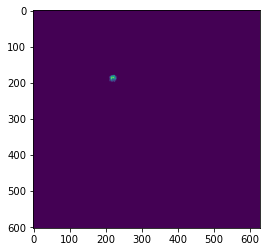

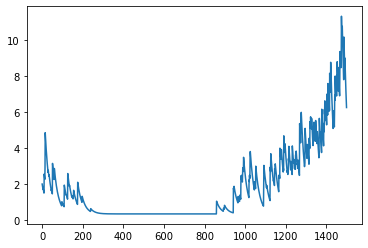

In [17]:
i = 91
plt.figure();
plt.imshow(np.reshape(cnm.estimates.A[:, i].toarray(), dims, order='F'))
plt.figure();
plt.plot(cnm.estimates.C[i])

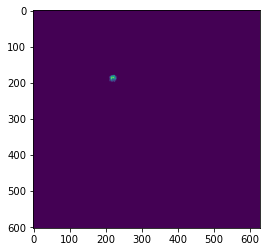

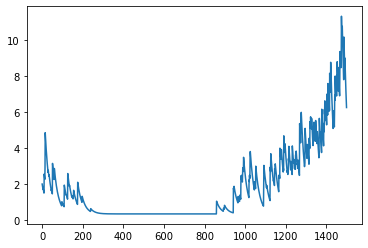

In [18]:
i = 91
plt.figure();
plt.imshow(np.reshape(cnm.estimates.A[:, i].toarray(), dims, order='F'))
plt.figure();
plt.plot(cnm.estimates.C[i])

In [ ]:
np.array(cnm.estimates.C)

## reconstruct denoised movie

In [19]:
denoised = cm.movie(cnm.estimates.A.dot(cnm.estimates.C)).reshape(dims + (-1,), order='F').transpose([2, 0, 1])

In [20]:
denoised.save('E:\\denoised.tif')

     1431687 [timeseries.py:                save():171] [17088] Parsing extension .tif
     1431688 [timeseries.py:                 foo():178] [17088] 0 frames saved
     1434113 [timeseries.py:                 foo():178] [17088] 200 frames saved
     1436301 [timeseries.py:                 foo():178] [17088] 400 frames saved
     1438657 [timeseries.py:                 foo():178] [17088] 600 frames saved
     1440998 [timeseries.py:                 foo():178] [17088] 800 frames saved
     1443349 [timeseries.py:                 foo():178] [17088] 1000 frames saved
     1445693 [timeseries.py:                 foo():178] [17088] 1200 frames saved
     1448010 [timeseries.py:                 foo():178] [17088] 1400 frames saved
